In [4]:
import sys
import os
import importlib
# make the module available from the src directory
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [5]:
from src.dataLoaders.DataLoader import DataSetLoader
importlib.reload(sys.modules['src.dataLoaders.DataLoader'])

data_dir = '../datasets/artificial_data/'
dataset = 'ContSimpleNoisyImageGeneratorMoreSmallCircles'
data_loader = DataSetLoader(data_dir=f'{data_dir}{dataset}')
data_loader.load_data()

In [6]:
from src.models.baseModels.resnet_regression import ResNetModel
importlib.reload(sys.modules['src.models.baseModels.resnet_regression'])

# data_dir = '../datasets/artificial_data/'
# dataset_name = 'ContSimpleNoisyImageGeneratorMoreSmallCircles'


resnet = ResNetModel(
    data_dir=f'{data_dir}{dataset}', 
    num_epochs=5,
    learning_rate=0.01,
    weight_decay=1e-4,
    early_stopping_tol=30,
    early_stopping_min_delta=30,
    depth=18,
    dataLoader=data_loader,
)


# resnet.load_data()
resnet.train()
resnet.evaluate()

Is cuda available:  True
Is mps available:  False
Epoch 1/5, Train Loss: 3.68703669128957e+16, Val Loss: 1.1023107169960216e+17
Epoch 2/5, Train Loss: 4887410134.206914, Val Loss: 15384908258.860033
Epoch 3/5, Train Loss: 123240464.76800984, Val Loss: 371236921.5632583
Epoch 4/5, Train Loss: 898.639501307873, Val Loss: 2566.2596360463945
Epoch 5/5, Train Loss: 276.3119806330255, Val Loss: 716.2872362893726
Loss of the network on the test images: 265.4258129785931
R^2 score of the network on the test images: -3.817230701446533


Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0003, device='cuda:0', grad_fn=<MaxBackward1>)


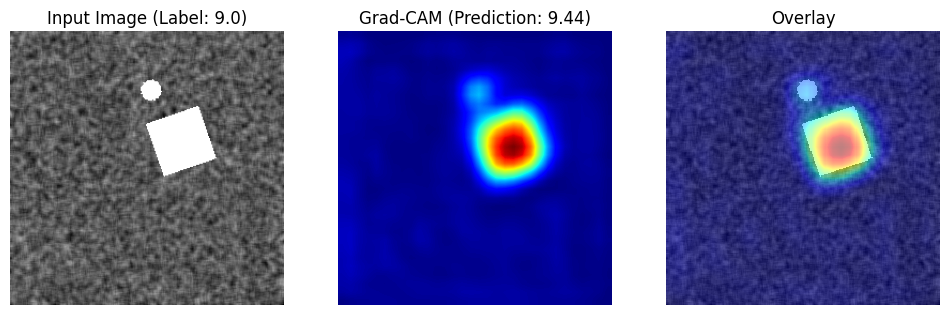

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0003, device='cuda:0', grad_fn=<MaxBackward1>)


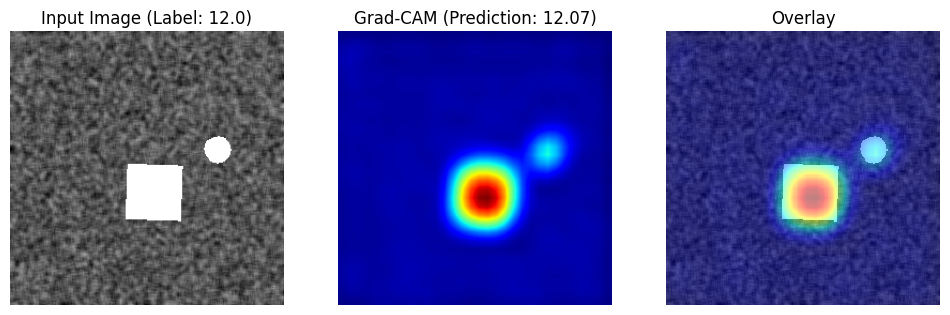

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0003, device='cuda:0', grad_fn=<MaxBackward1>)


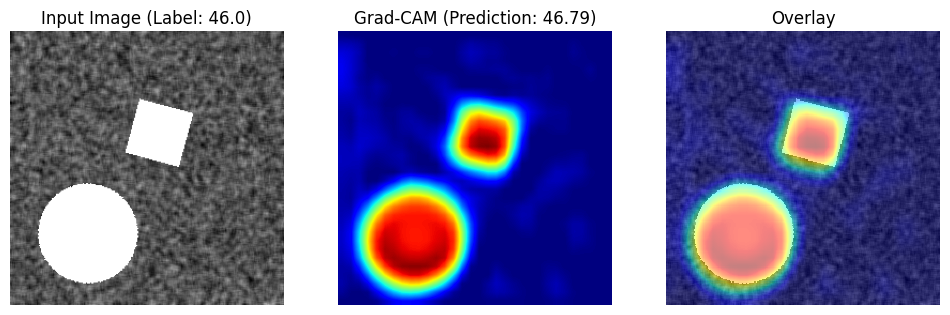

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0005, device='cuda:0', grad_fn=<MaxBackward1>)


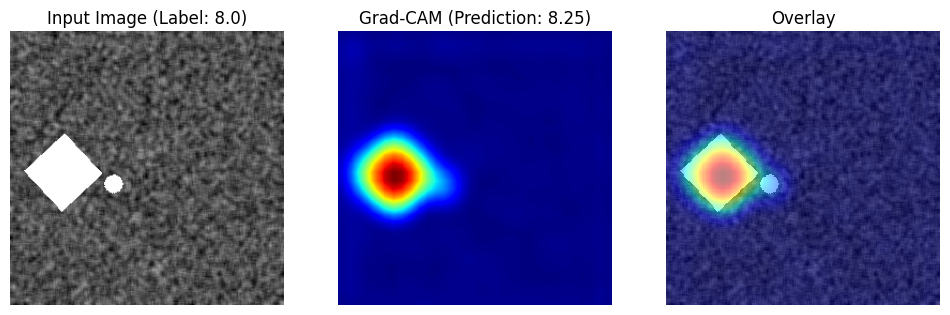

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0005, device='cuda:0', grad_fn=<MaxBackward1>)


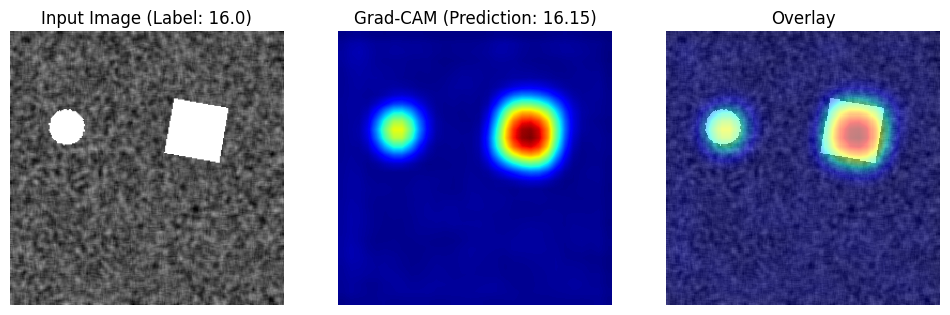

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0005, device='cuda:0', grad_fn=<MaxBackward1>)


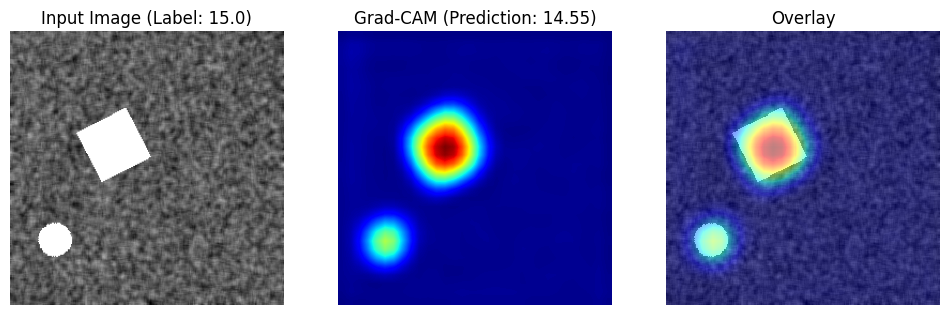

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0002, device='cuda:0', grad_fn=<MaxBackward1>)


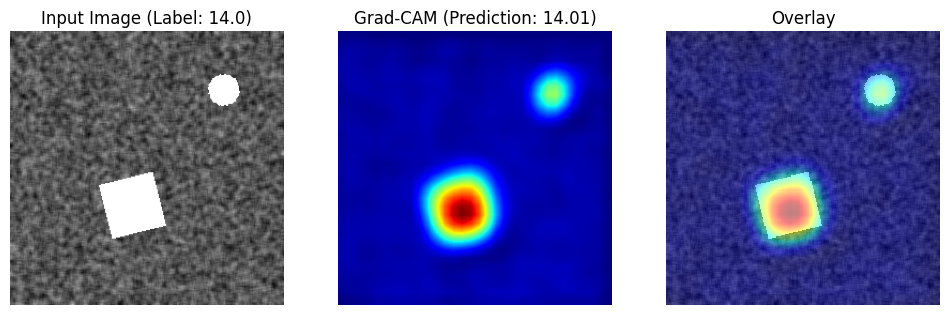

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0004, device='cuda:0', grad_fn=<MaxBackward1>)


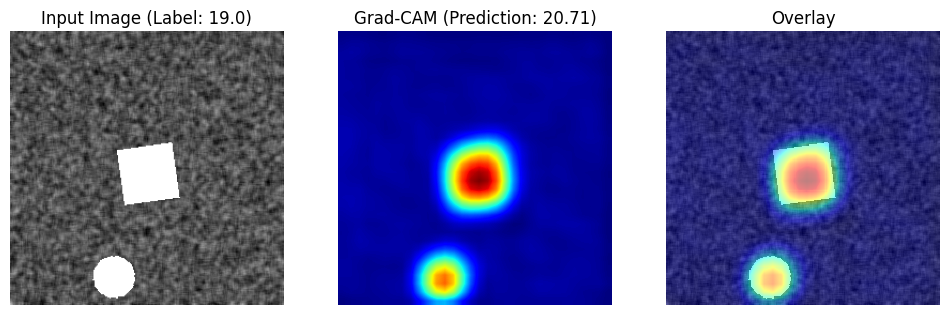

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0005, device='cuda:0', grad_fn=<MaxBackward1>)


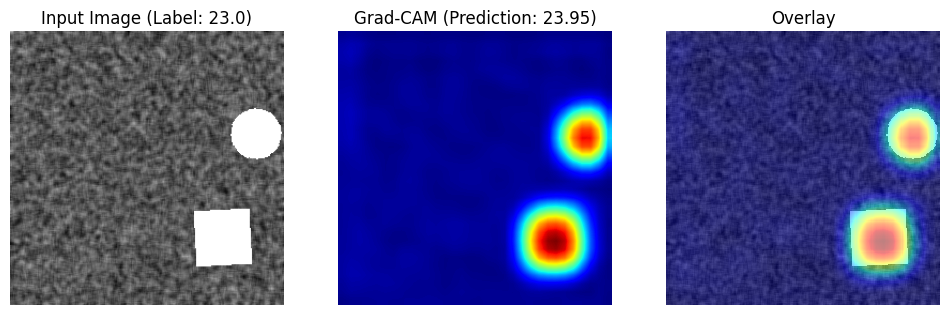

Found 10 instances of Conv2d layers.
Max value in heatmap before ReLU is: tensor(0.0003, device='cuda:0', grad_fn=<MaxBackward1>)


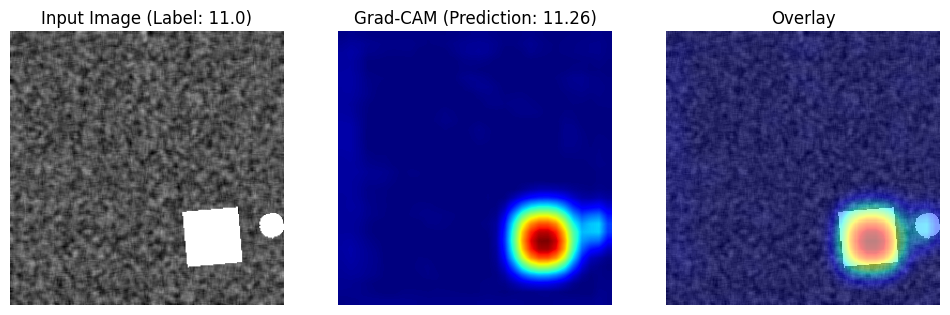

In [12]:
from src.XAI.GradCam import GradCamResnet
importlib.reload(sys.modules['src.XAI.GradCam'])
importlib.reload(sys.modules['src.XAI.utils.SaveFiles'])

grad_cam = GradCamResnet(resnet, layerCount=10)
grad_cam.generateMultipleGradCam(10, save_output=False, save_dir='small_circle_only')

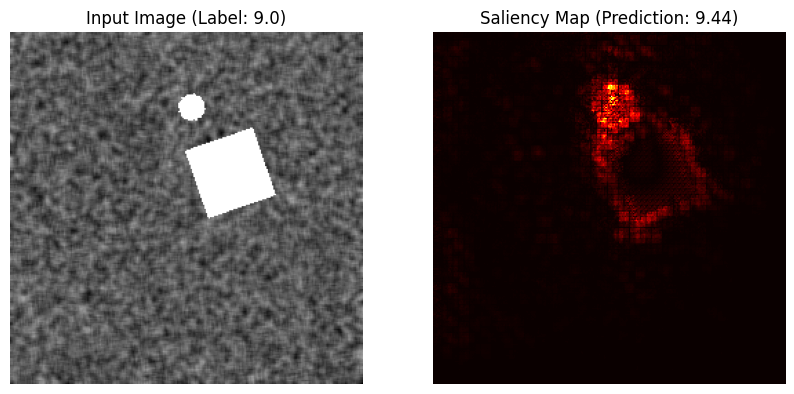

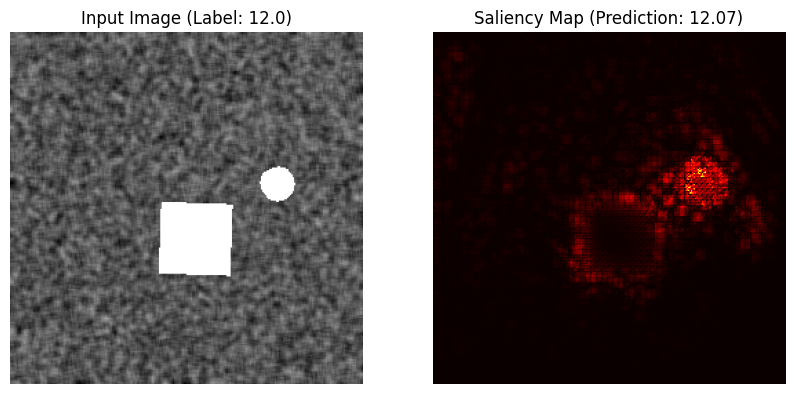

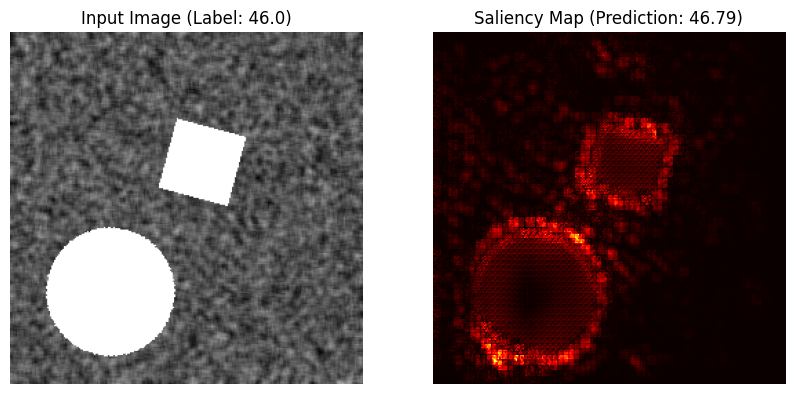

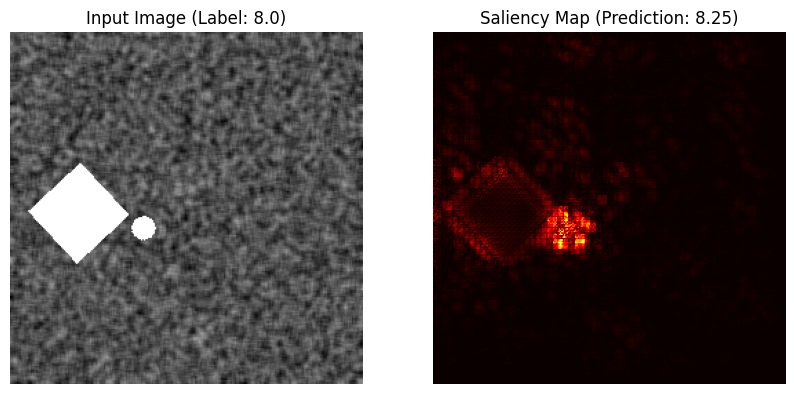

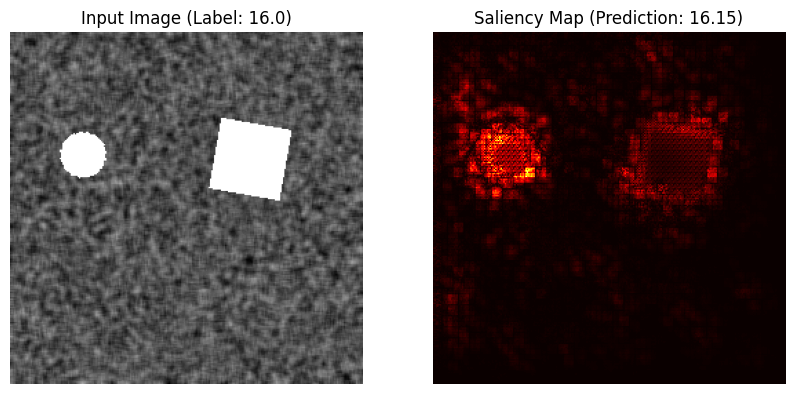

...

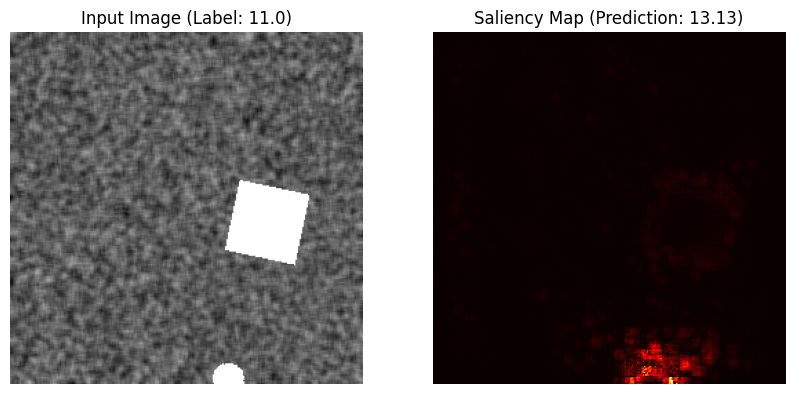

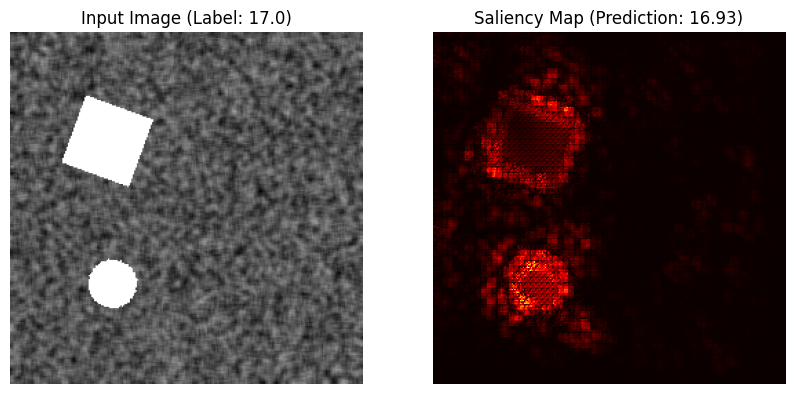

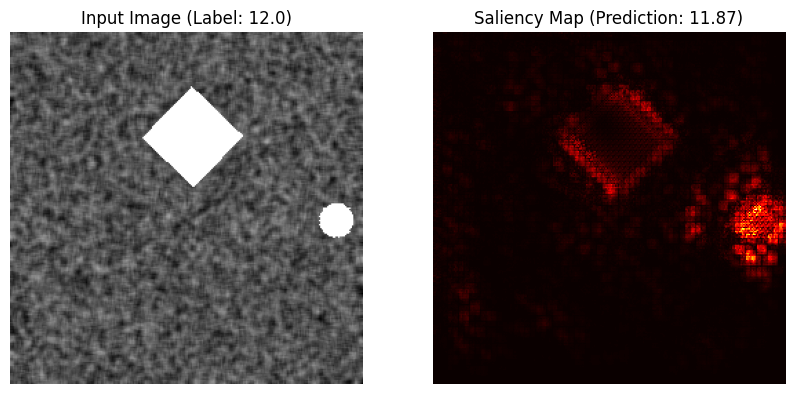

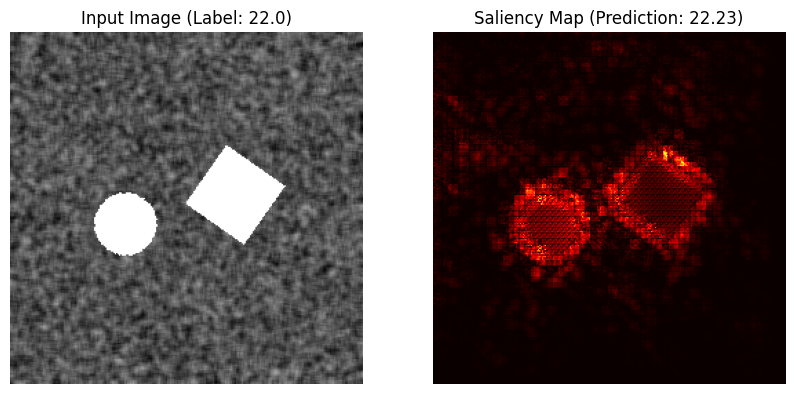

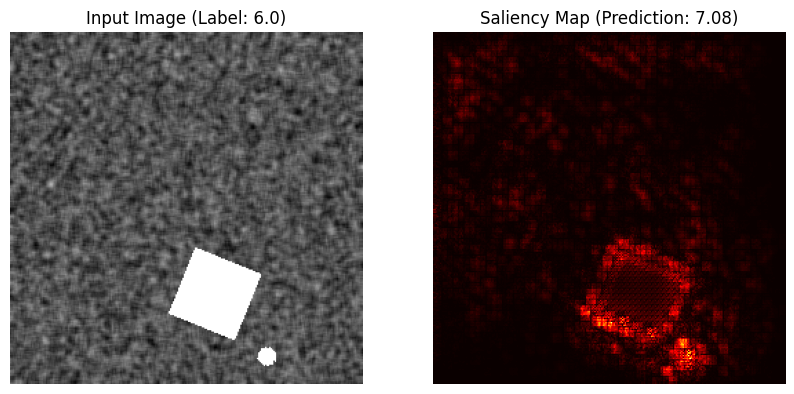

In [7]:
from src.XAI.VanillaSaliency import VanillaSaliency
importlib.reload(sys.modules['src.XAI.VanillaSaliency'])

# Assuming XAIResNet was already imported previously

# Initialize XAI instance
xai_resnet = VanillaSaliency(modelWrapper=resnet, device=resnet.device)
xai_resnet.get_saliency_maps(image_count=50)

In [14]:
import torch
print(torch.__version__)

2.2.2+cu121


Max value in heatmap before ReLU is: tensor(0.0038, device='mps:0', grad_fn=<MaxBackward1>)


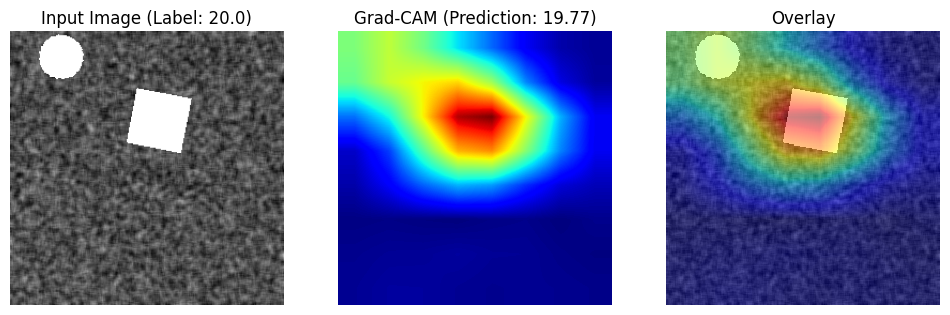

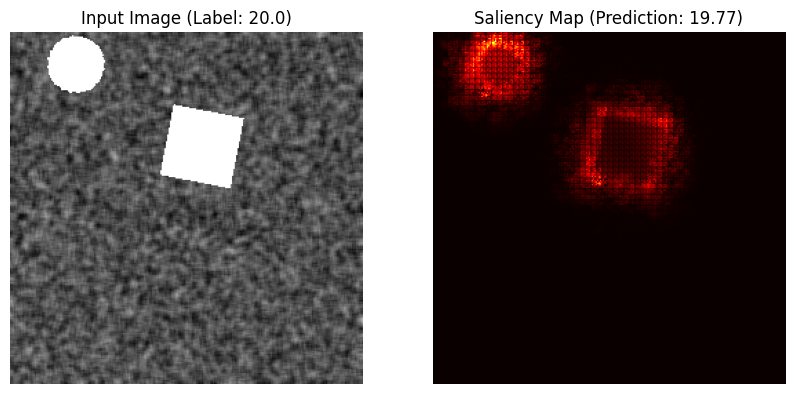

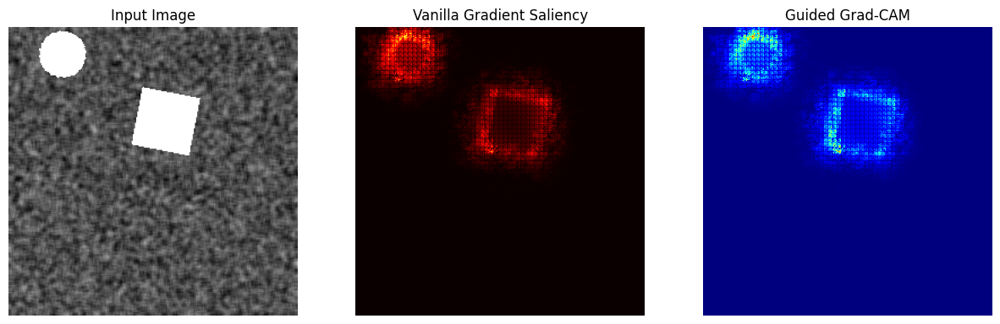

Max value in heatmap before ReLU is: tensor(0.0030, device='mps:0', grad_fn=<MaxBackward1>)


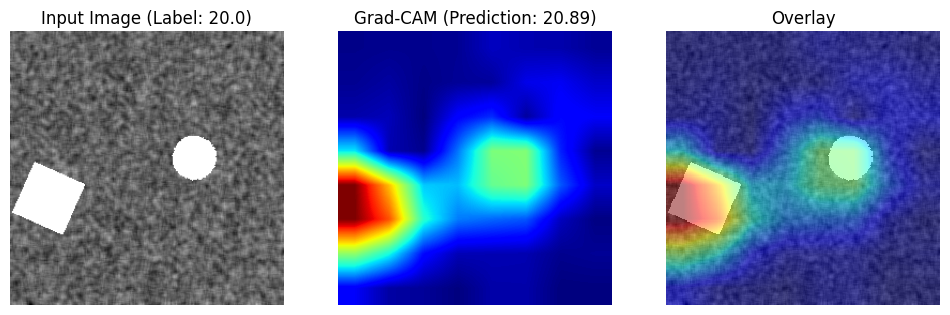

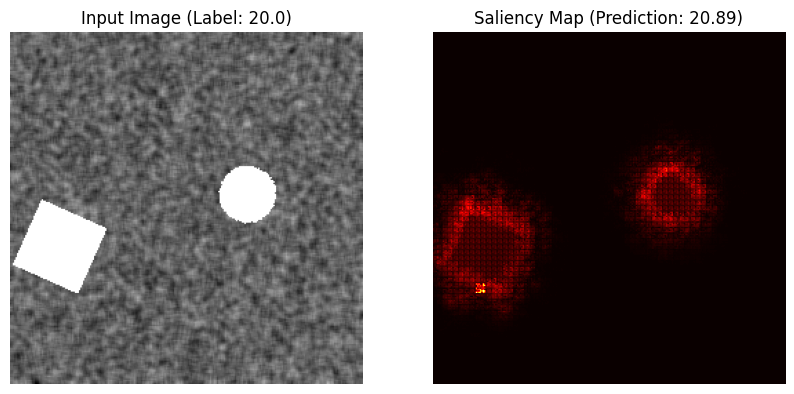

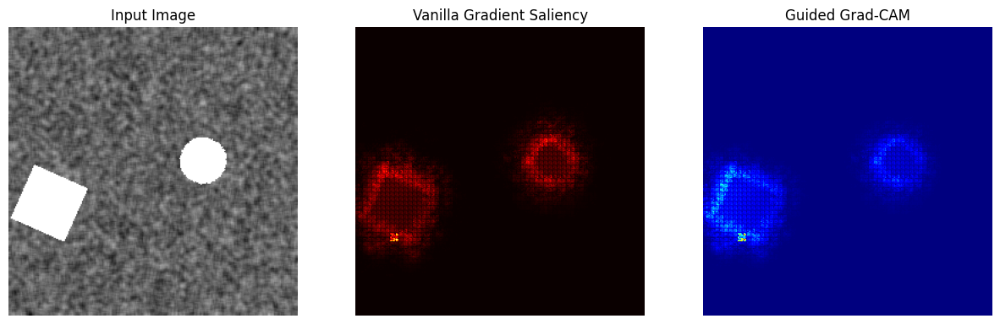

Max value in heatmap before ReLU is: tensor(0.0041, device='mps:0', grad_fn=<MaxBackward1>)


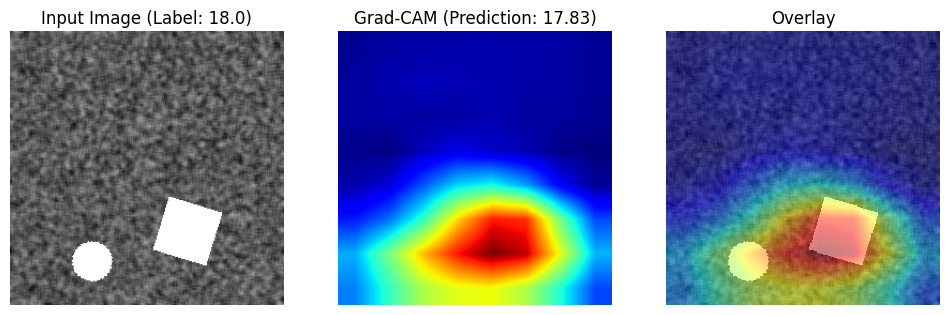

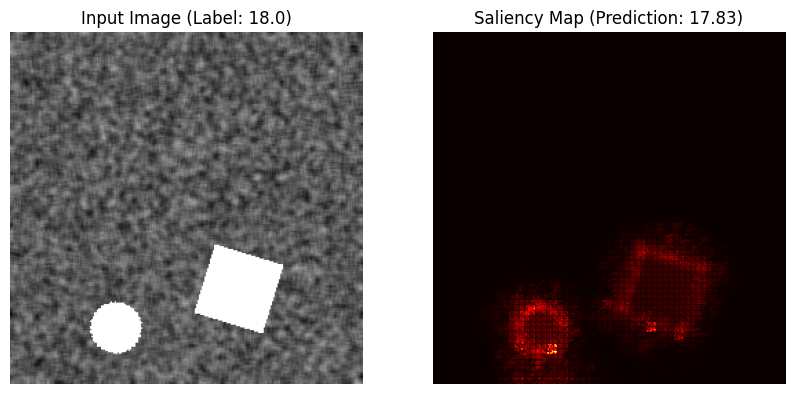

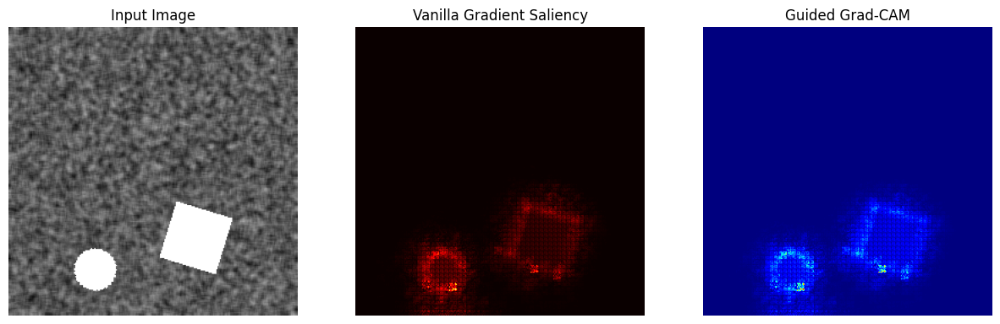

Max value in heatmap before ReLU is: tensor(0.0023, device='mps:0', grad_fn=<MaxBackward1>)


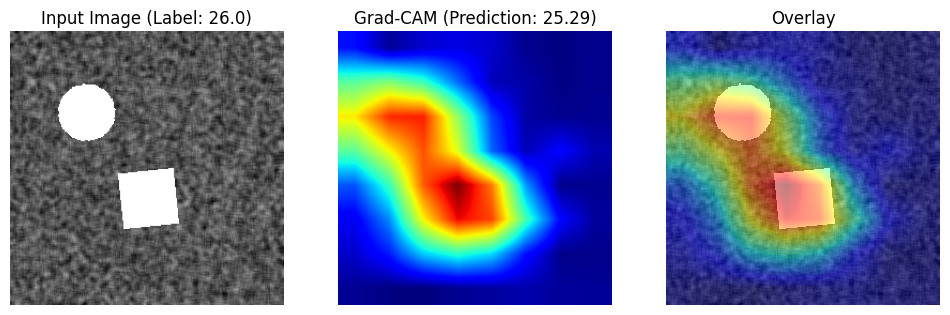

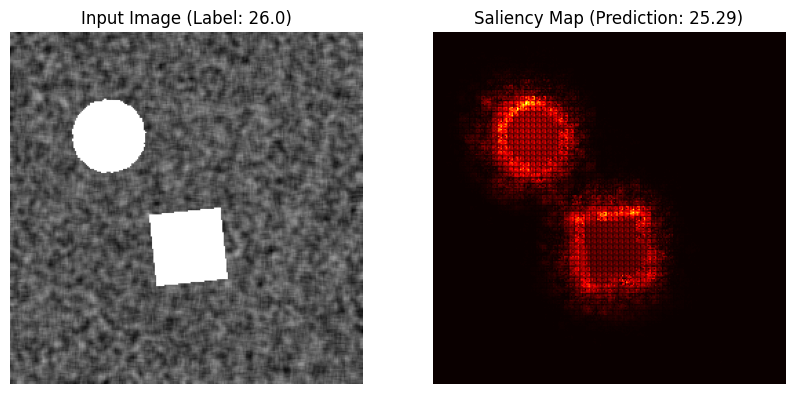

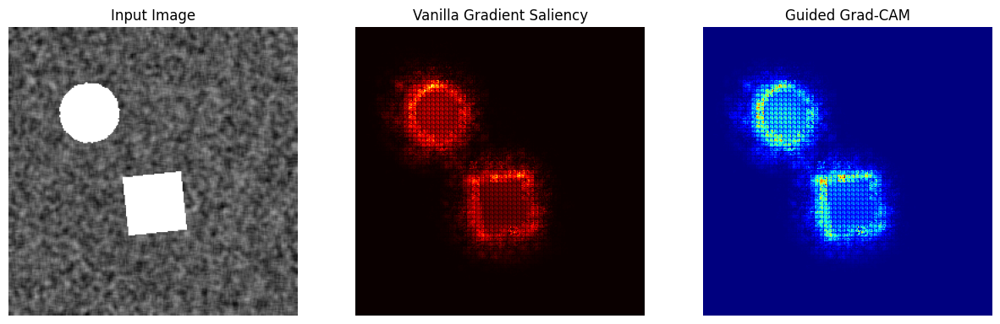

Max value in heatmap before ReLU is: tensor(0.0036, device='mps:0', grad_fn=<MaxBackward1>)


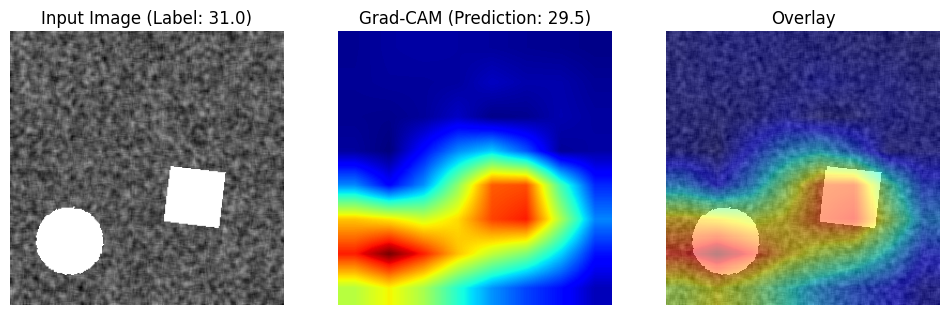

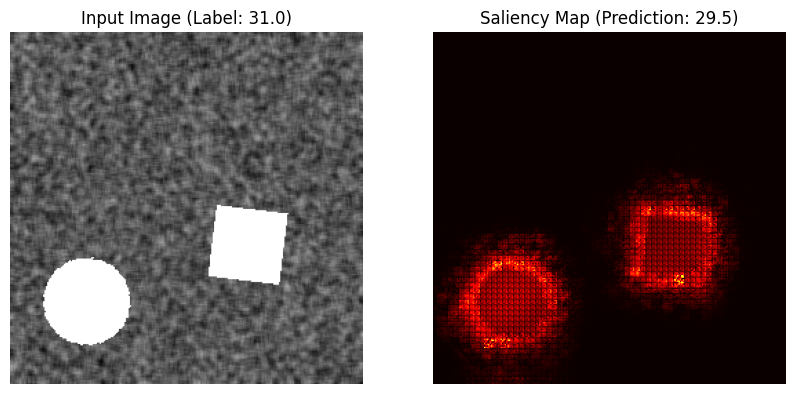

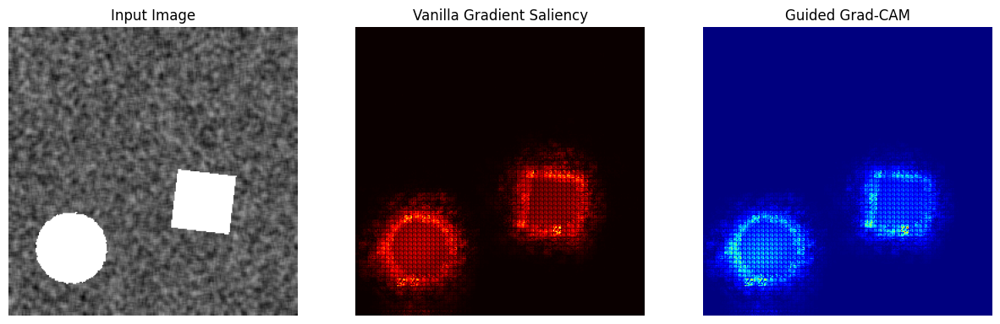

Max value in heatmap before ReLU is: tensor(0.0040, device='mps:0', grad_fn=<MaxBackward1>)


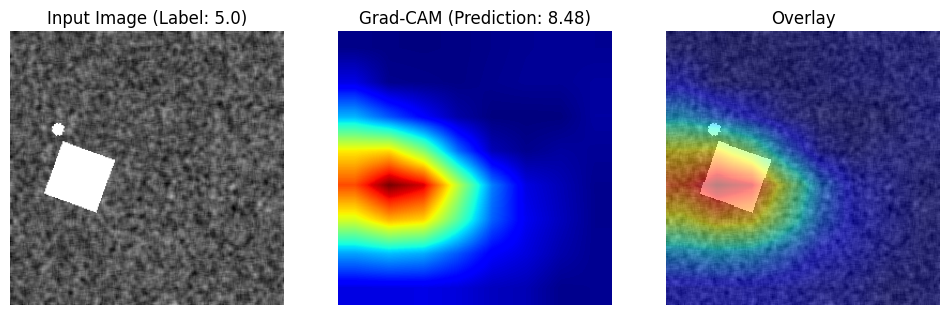

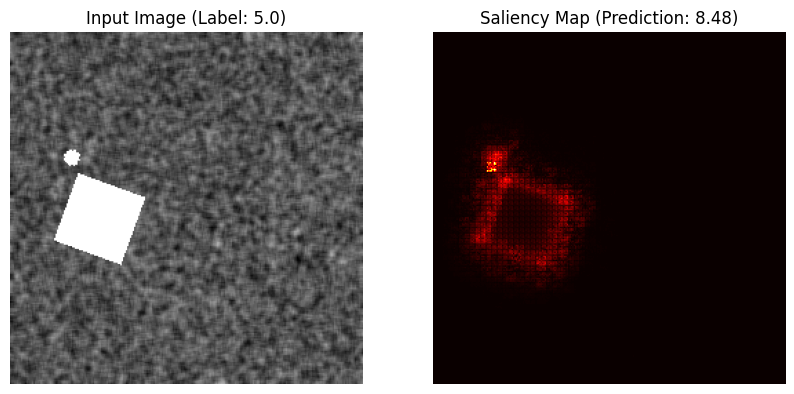

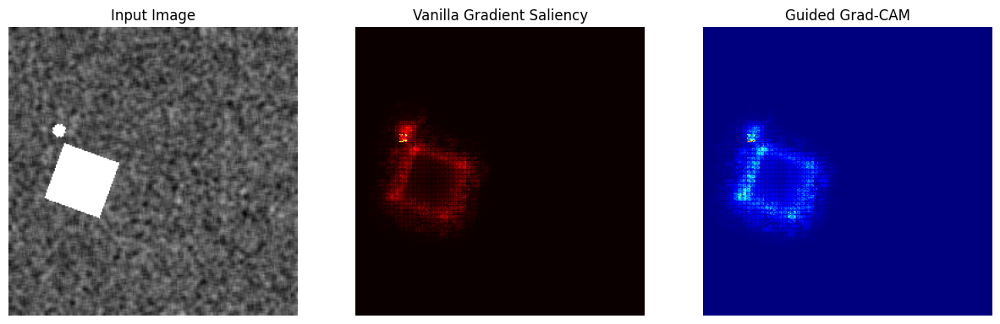

Max value in heatmap before ReLU is: tensor(0.0029, device='mps:0', grad_fn=<MaxBackward1>)


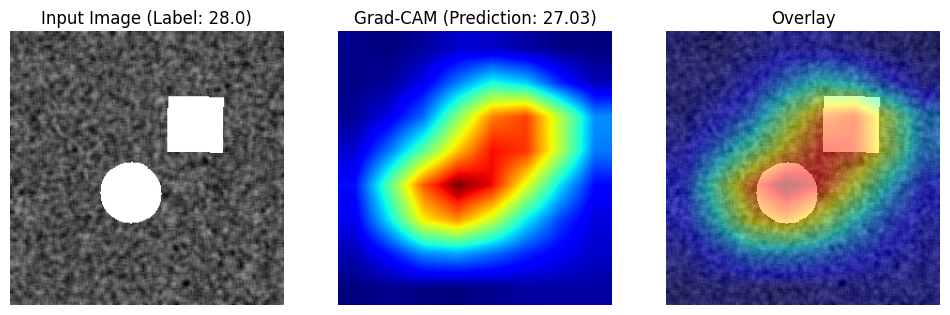

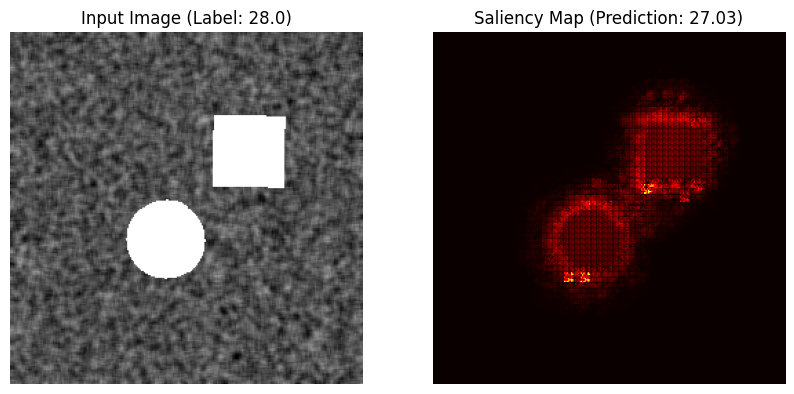

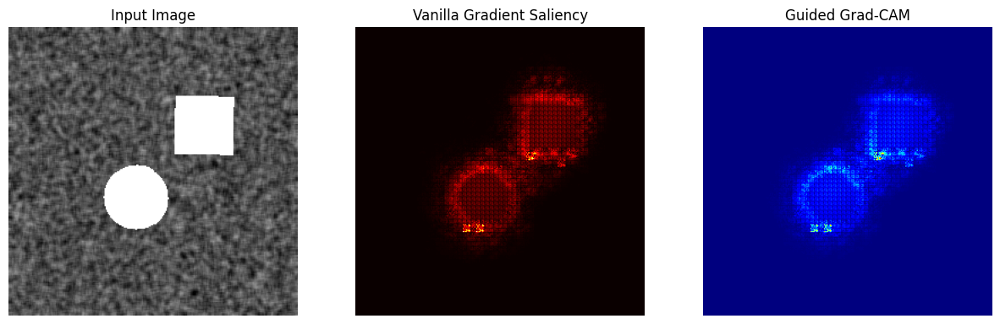

Max value in heatmap before ReLU is: tensor(0.0033, device='mps:0', grad_fn=<MaxBackward1>)


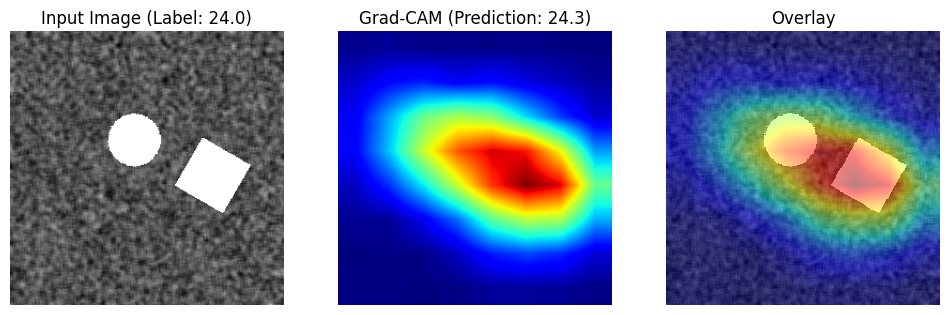

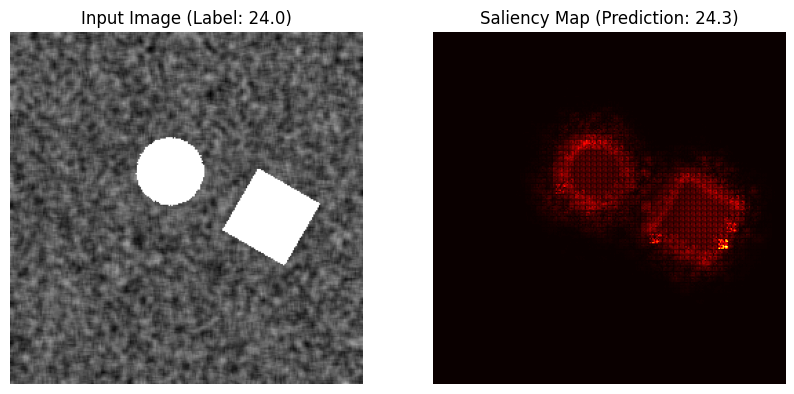

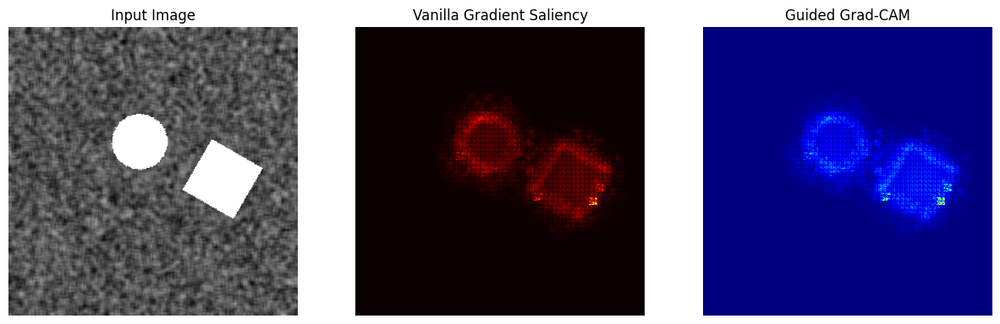

Max value in heatmap before ReLU is: tensor(0.0040, device='mps:0', grad_fn=<MaxBackward1>)


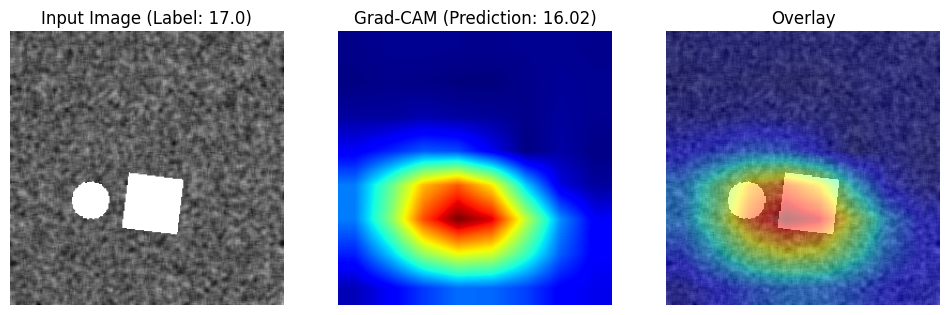

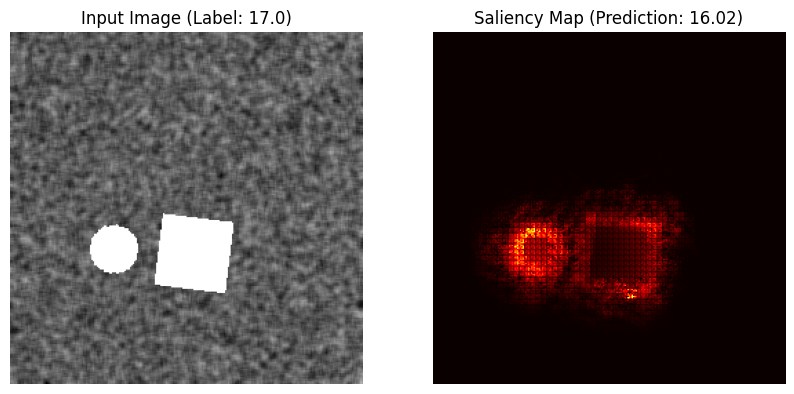

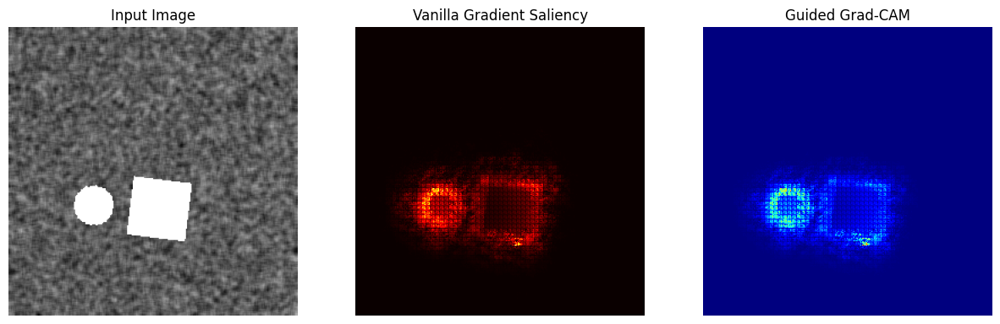

Max value in heatmap before ReLU is: tensor(0.0022, device='mps:0', grad_fn=<MaxBackward1>)


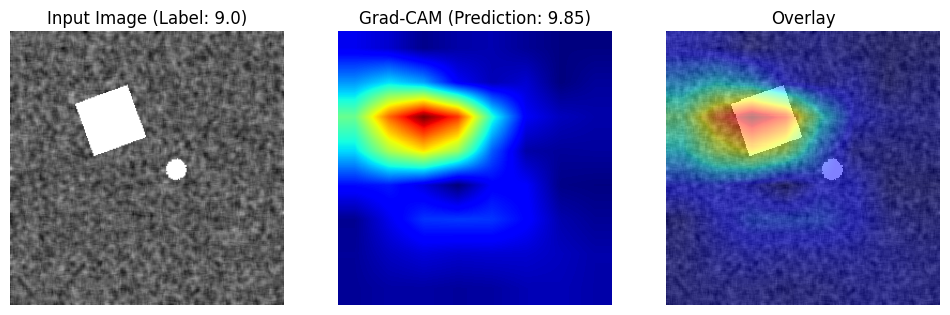

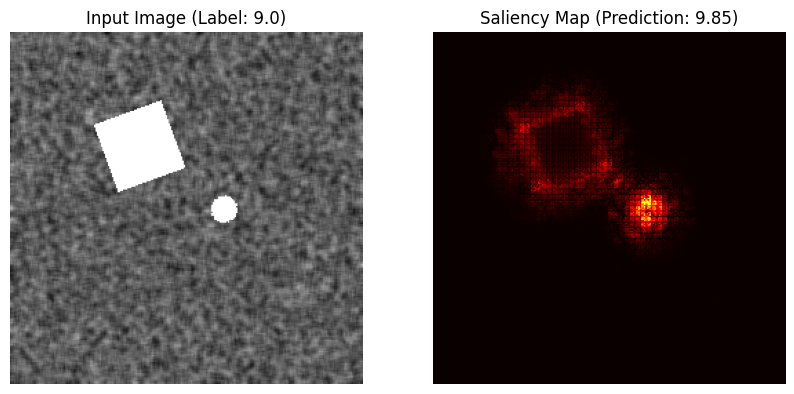

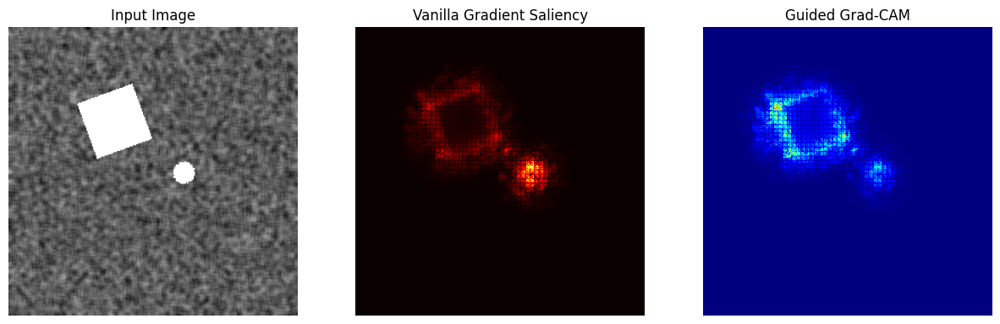

Max value in heatmap before ReLU is: tensor(0.0035, device='mps:0', grad_fn=<MaxBackward1>)


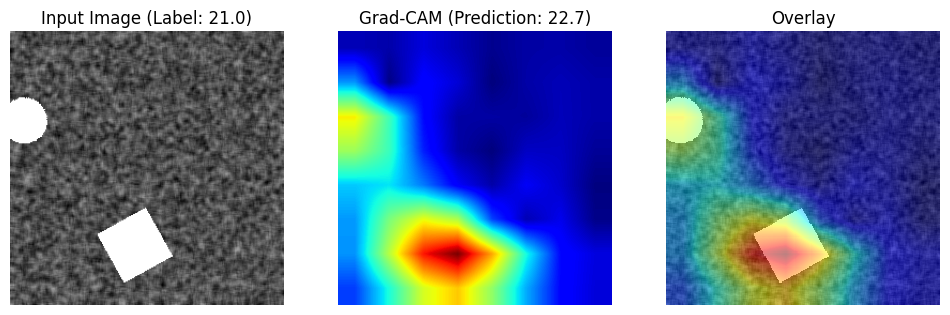

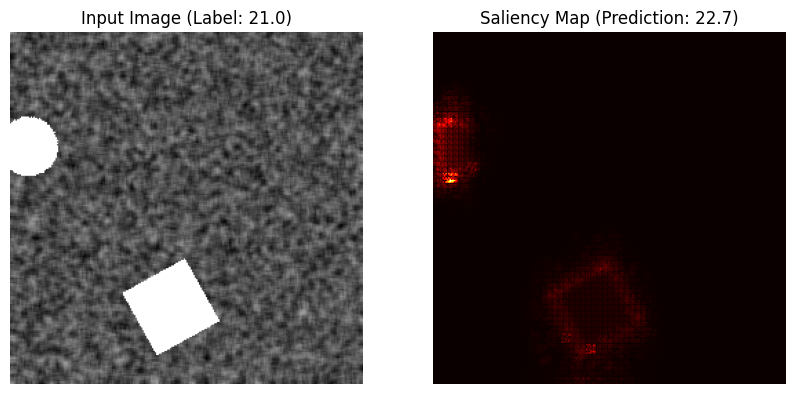

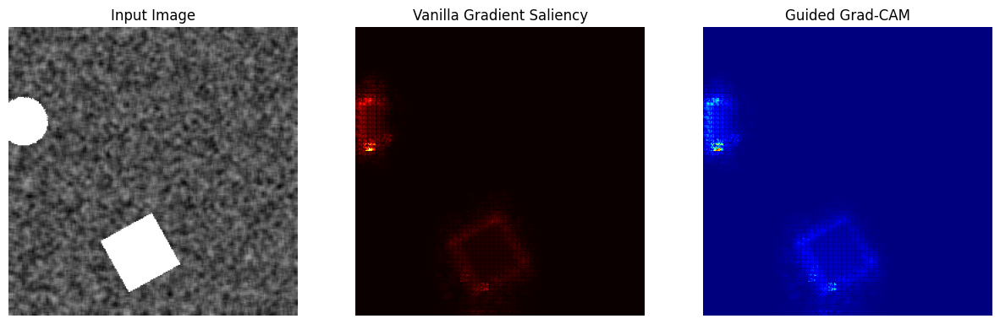

Max value in heatmap before ReLU is: tensor(0.0037, device='mps:0', grad_fn=<MaxBackward1>)


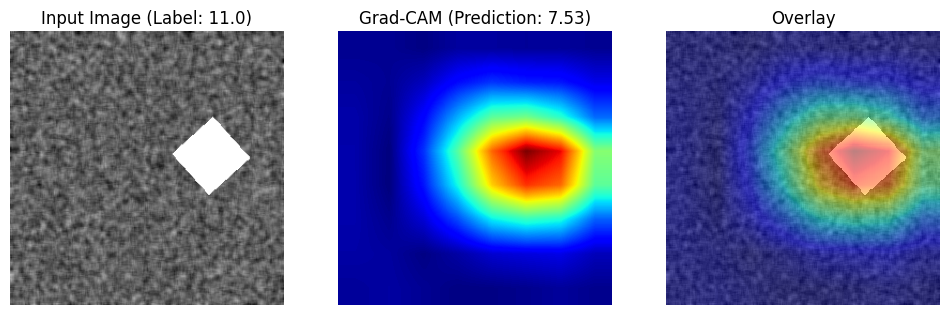

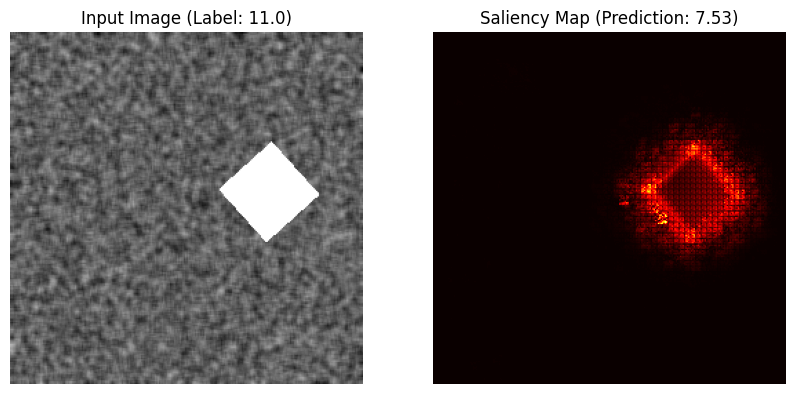

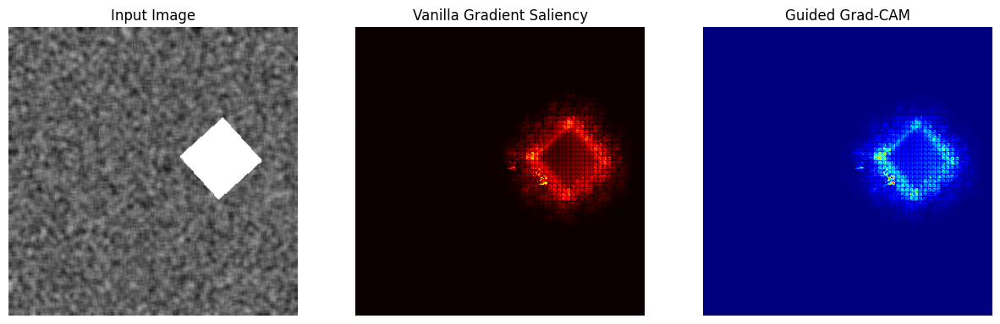

Max value in heatmap before ReLU is: tensor(0.0041, device='mps:0', grad_fn=<MaxBackward1>)


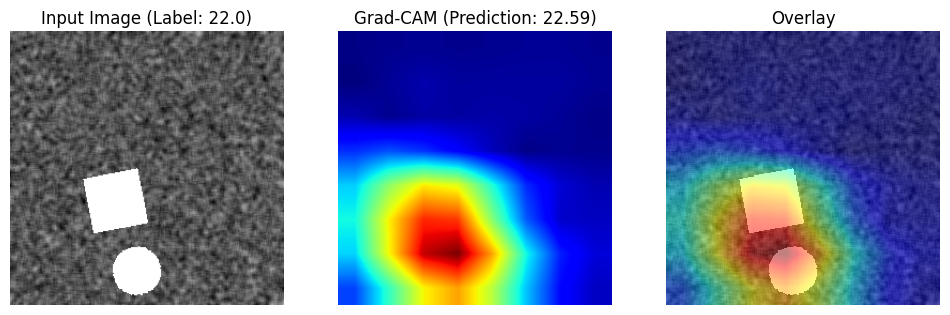

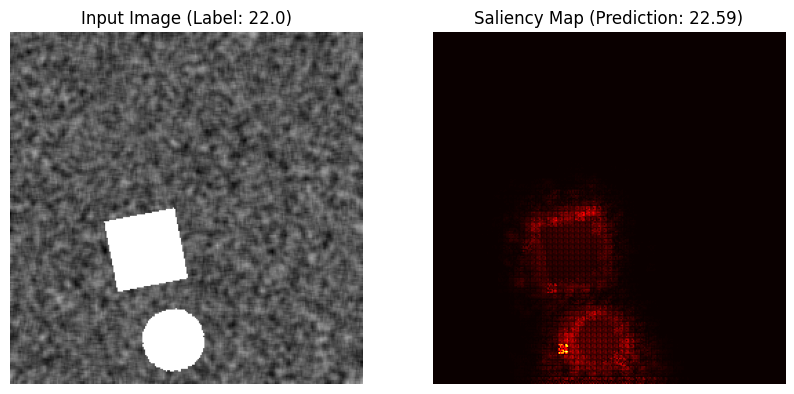

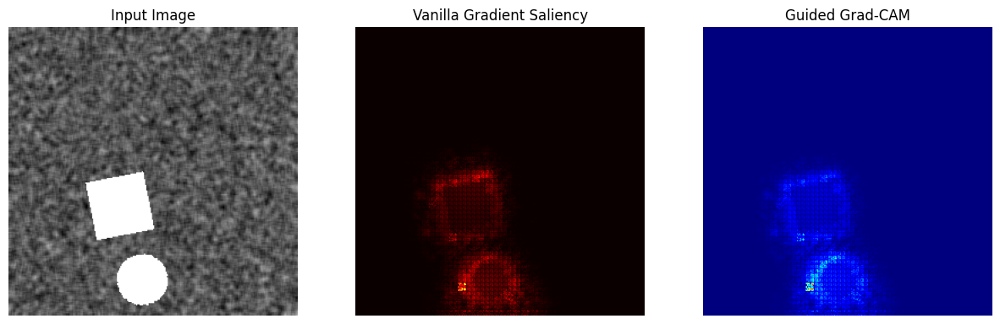

Max value in heatmap before ReLU is: tensor(0.0032, device='mps:0', grad_fn=<MaxBackward1>)


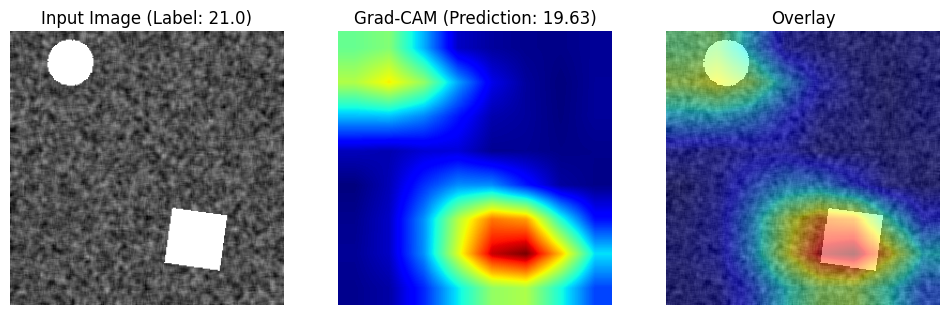

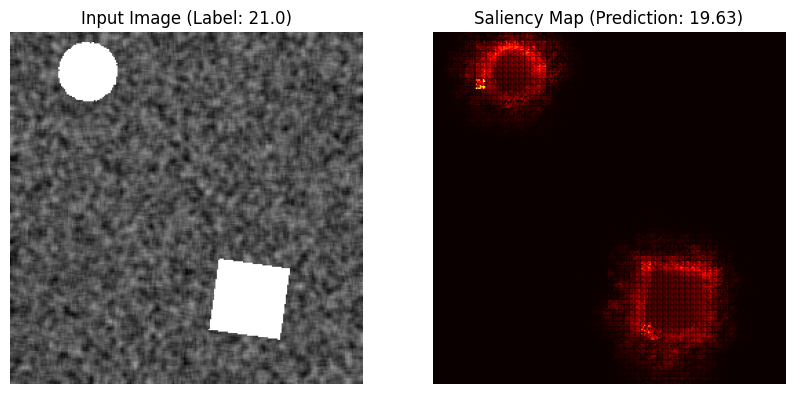

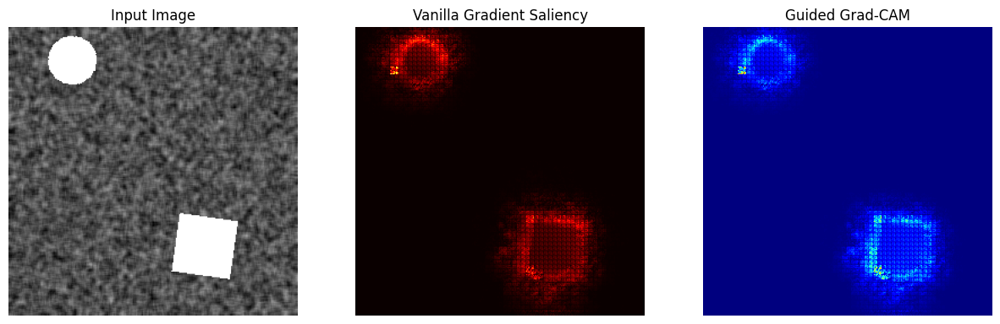

Max value in heatmap before ReLU is: tensor(0.0030, device='mps:0', grad_fn=<MaxBackward1>)


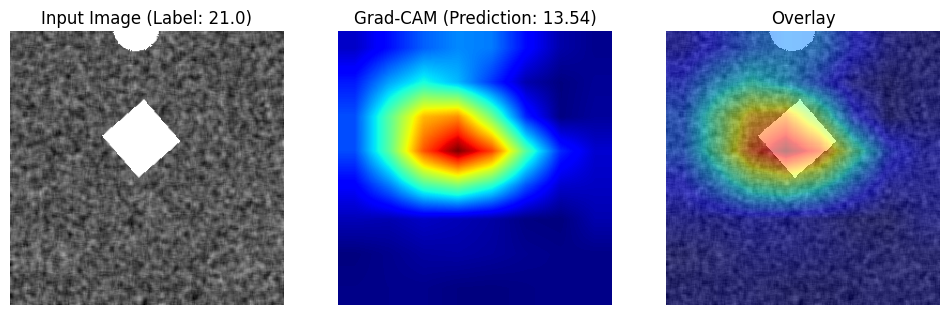

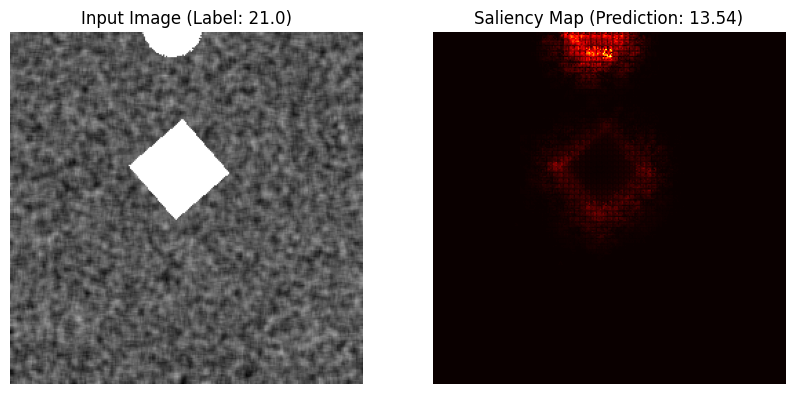

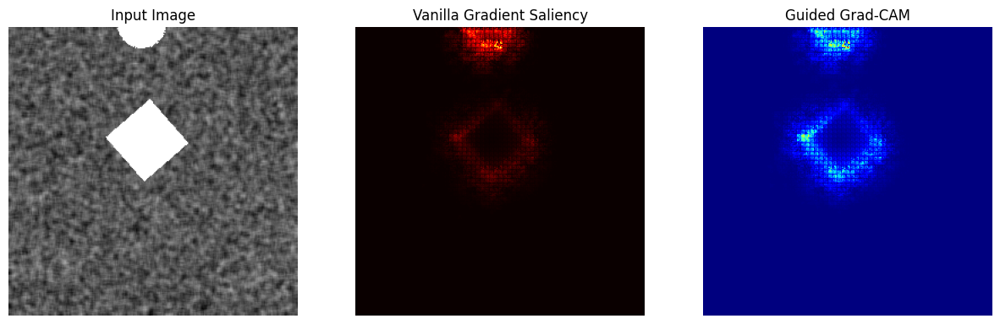

Max value in heatmap before ReLU is: tensor(0.0037, device='mps:0', grad_fn=<MaxBackward1>)


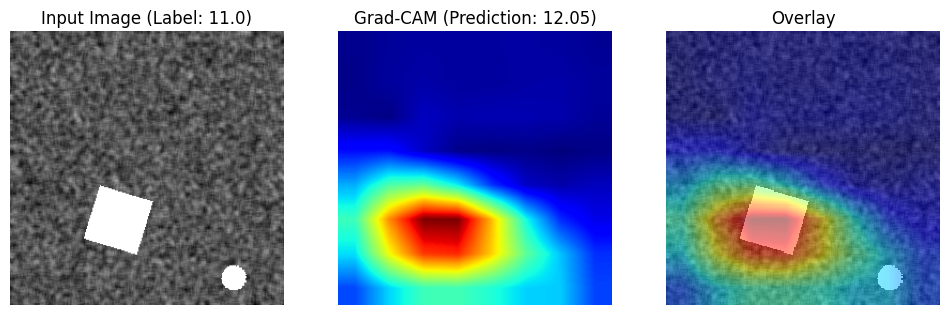

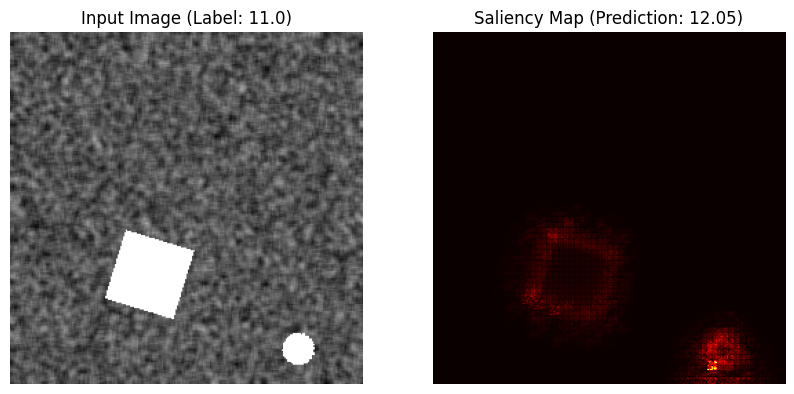

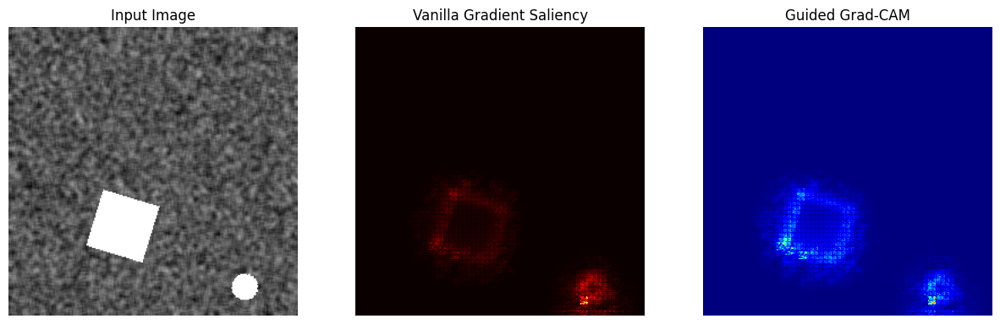

Max value in heatmap before ReLU is: tensor(0.0030, device='mps:0', grad_fn=<MaxBackward1>)


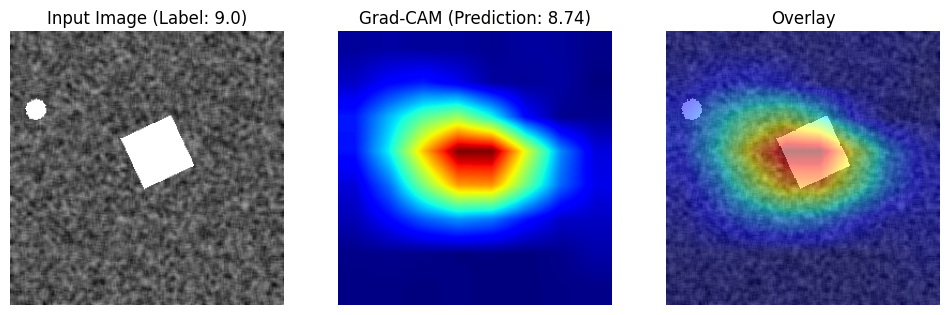

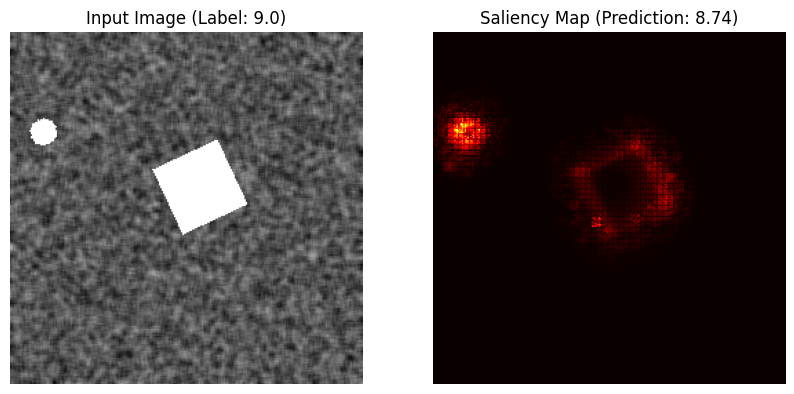

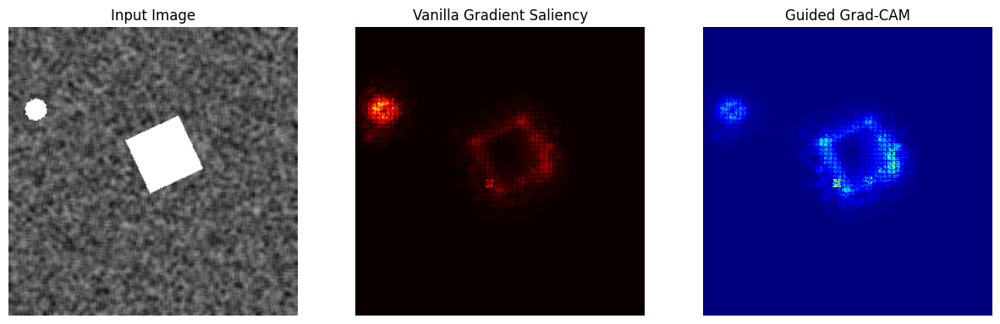

Max value in heatmap before ReLU is: tensor(0.0044, device='mps:0', grad_fn=<MaxBackward1>)


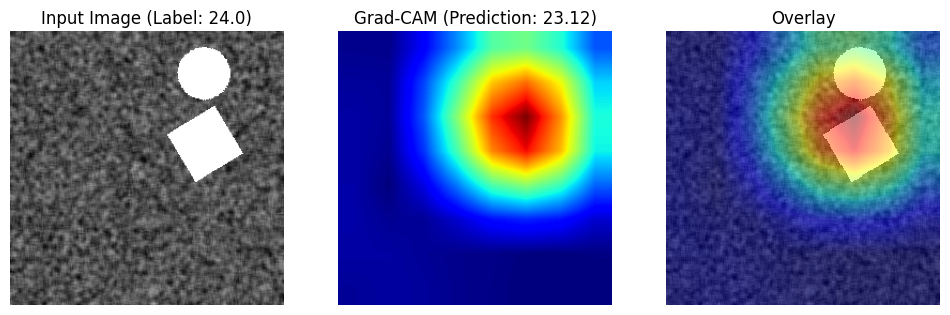

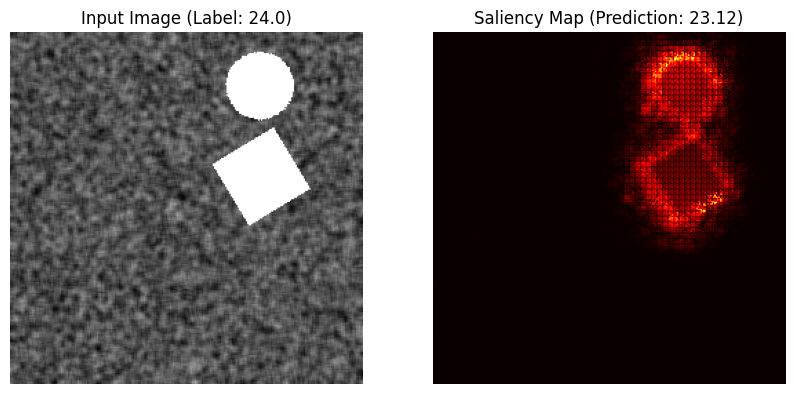

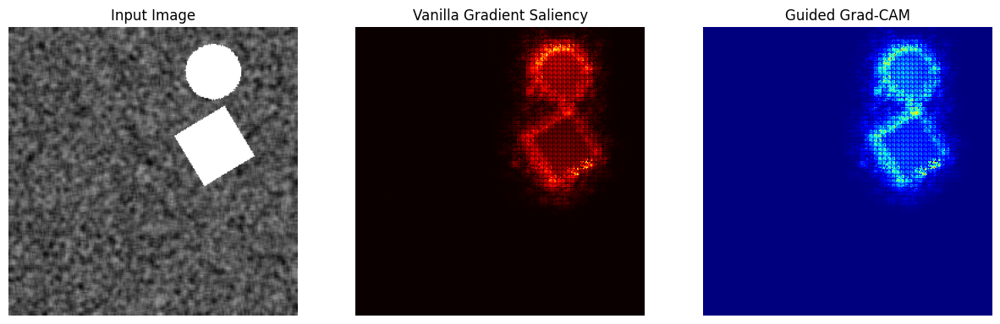

Max value in heatmap before ReLU is: tensor(0.0036, device='mps:0', grad_fn=<MaxBackward1>)


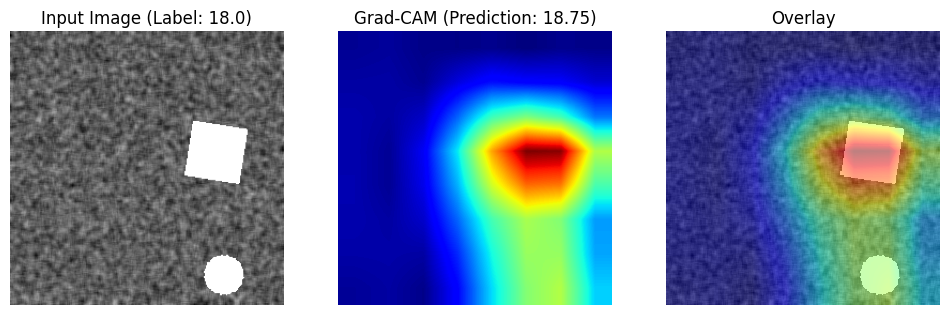

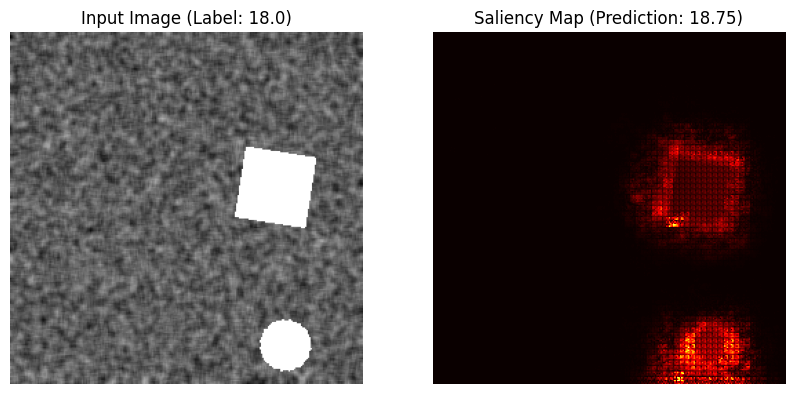

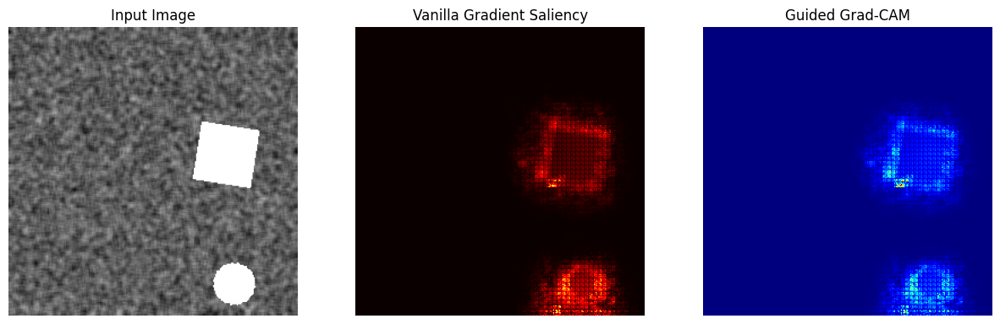

Max value in heatmap before ReLU is: tensor(0.0042, device='mps:0', grad_fn=<MaxBackward1>)


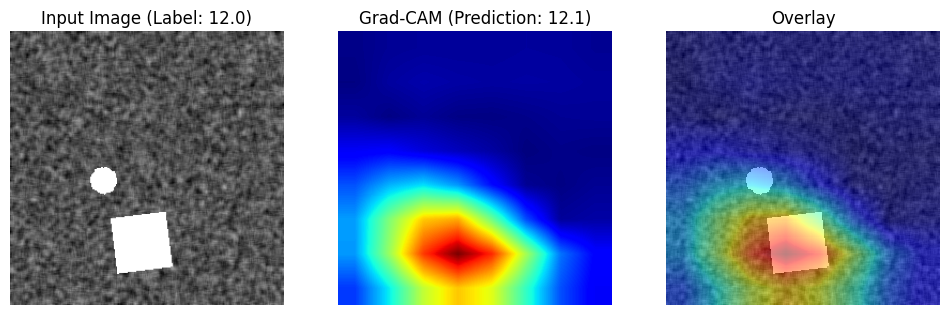

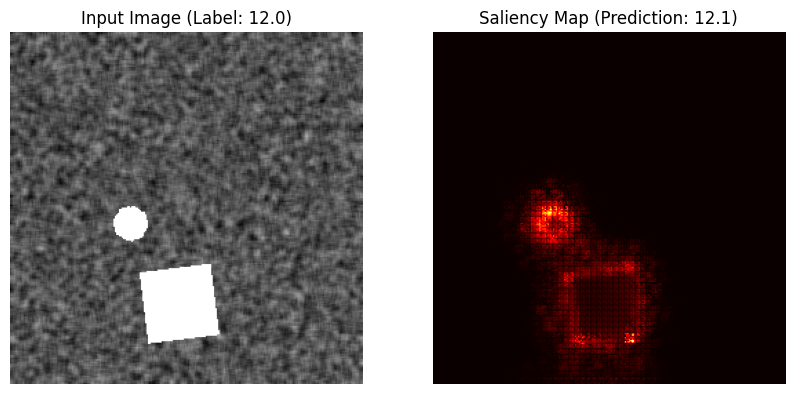

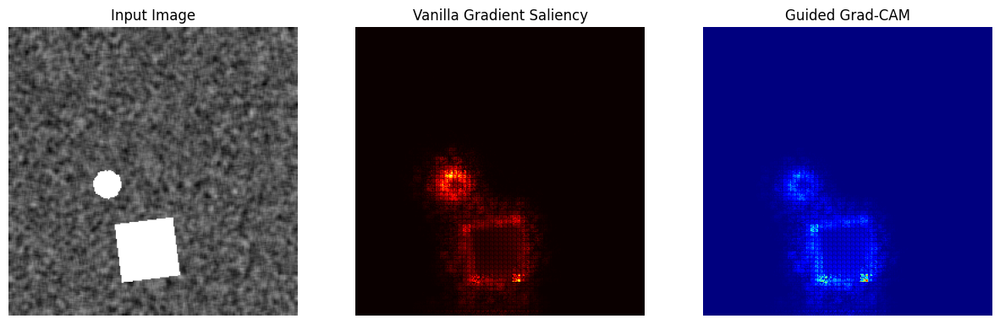

In [5]:
from src.XAI.GuideGradCam import GuidedGradCam
importlib.reload(sys.modules['src.XAI.GradCam'])
importlib.reload(sys.modules['src.XAI.VanillaSaliency'])
importlib.reload(sys.modules['src.XAI.GuideGradCam'])


# Assuming XAIResNet was alreFady imported previously

# Initialize XAI instance
guidedGradCam = GuidedGradCam(grad_cam=grad_cam, vanilla_saliency=xai_resnet)
for i in range(1):
    guidedGradCam.generate_guided_grad_cam(index=i)
# guidedGradCam.generate_guided_grad_cam(index=2)

Max value in heatmap before ReLU is: tensor(0.0008, device='cuda:0', grad_fn=<MaxBackward1>)


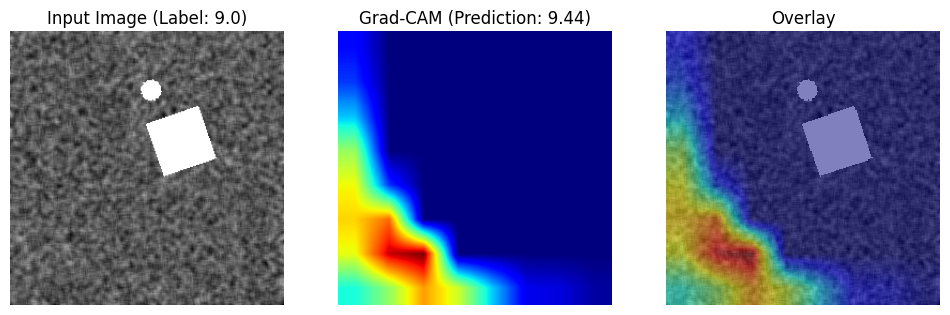

Max value in heatmap before ReLU is: tensor(0.0057, device='cuda:0', grad_fn=<MaxBackward1>)


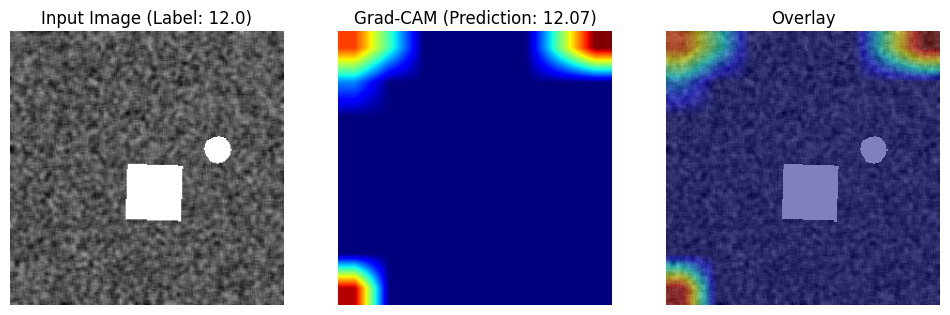

Max value in heatmap before ReLU is: tensor(0.0001, device='cuda:0', grad_fn=<MaxBackward1>)


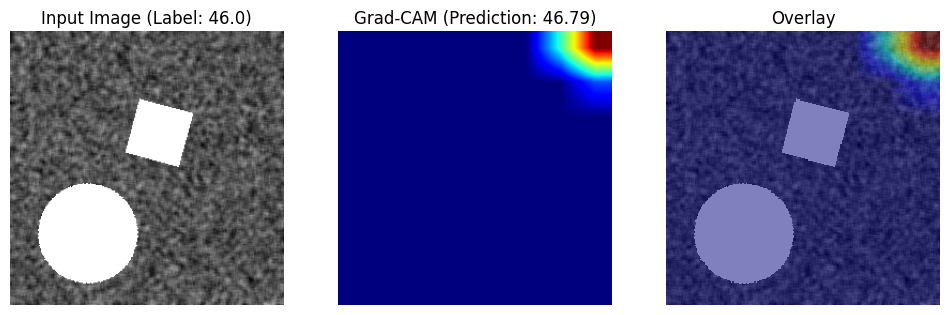

Max value in heatmap before ReLU is: tensor(0.0029, device='cuda:0', grad_fn=<MaxBackward1>)


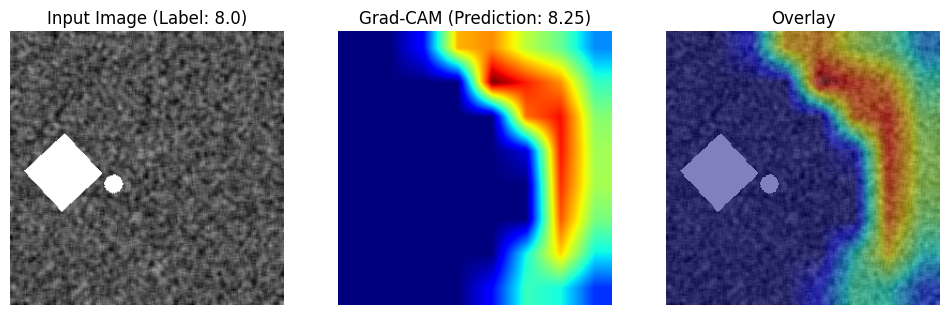

Max value in heatmap before ReLU is: tensor(0.0048, device='cuda:0', grad_fn=<MaxBackward1>)


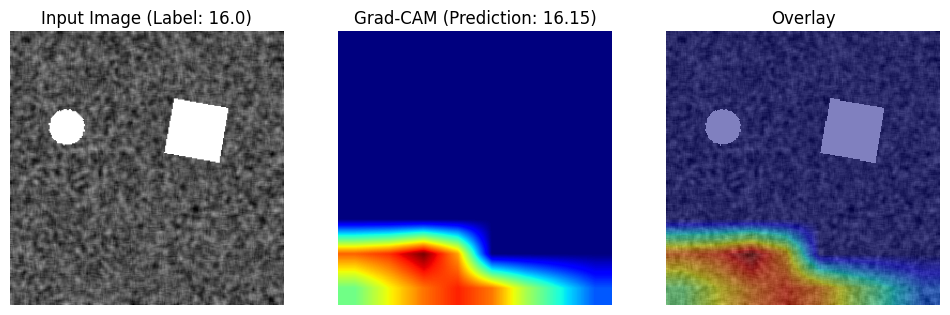

Max value in heatmap before ReLU is: tensor(0.0259, device='cuda:0', grad_fn=<MaxBackward1>)


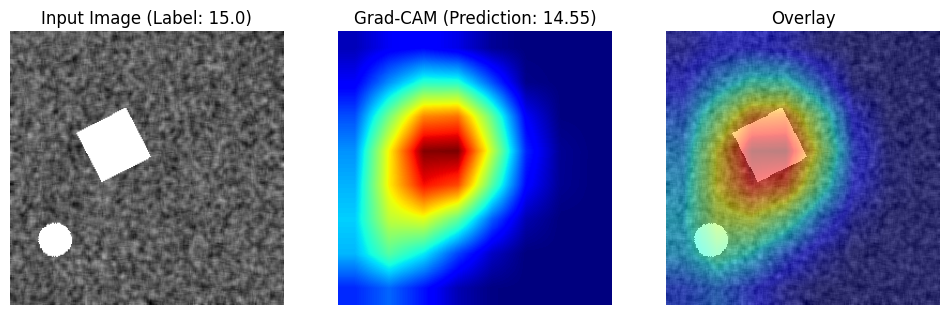

Max value in heatmap before ReLU is: tensor(0.2491, device='cuda:0', grad_fn=<MaxBackward1>)


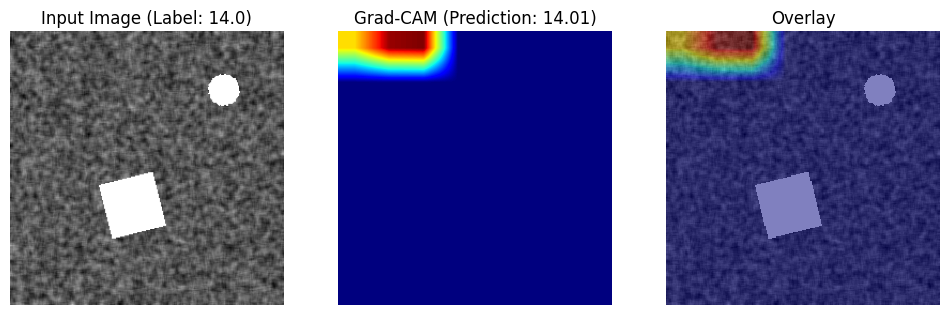

Max value in heatmap before ReLU is: tensor(3.6868e-05, device='cuda:0', grad_fn=<MaxBackward1>)


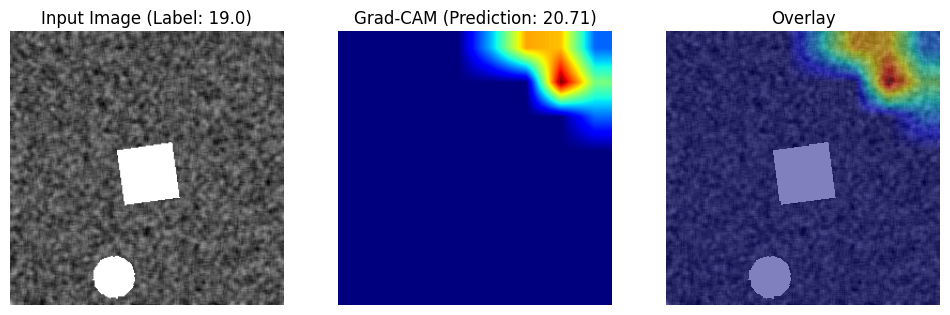

Max value in heatmap before ReLU is: tensor(0.0002, device='cuda:0', grad_fn=<MaxBackward1>)


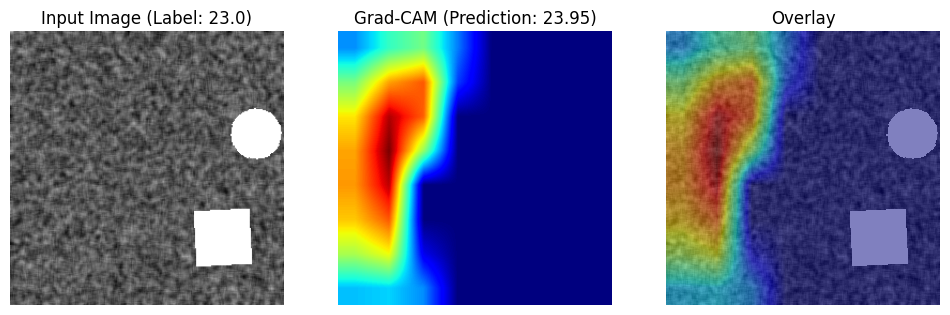

Max value in heatmap before ReLU is: tensor(0.0032, device='cuda:0', grad_fn=<MaxBackward1>)


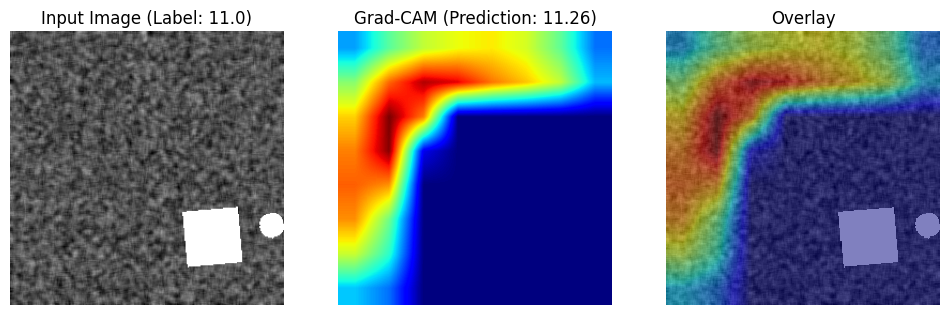

Max value in heatmap before ReLU is: tensor(1.1385, device='cuda:0', grad_fn=<MaxBackward1>)


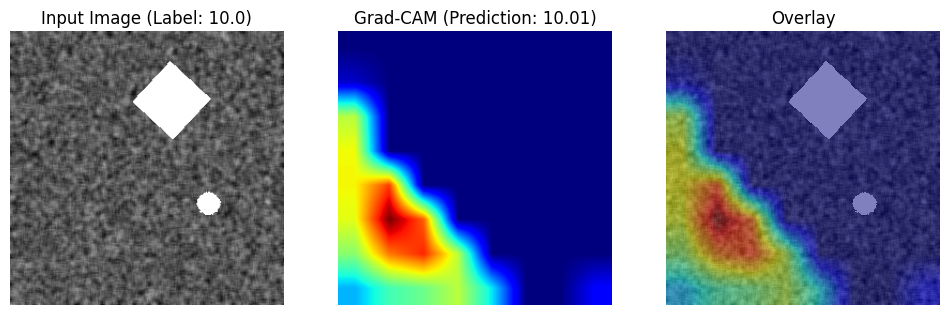

Max value in heatmap before ReLU is: tensor(8.9495, device='cuda:0', grad_fn=<MaxBackward1>)


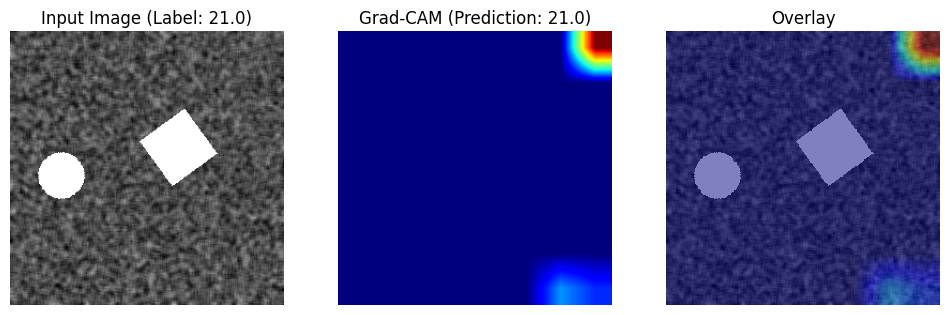

Max value in heatmap before ReLU is: tensor(0.0003, device='cuda:0', grad_fn=<MaxBackward1>)


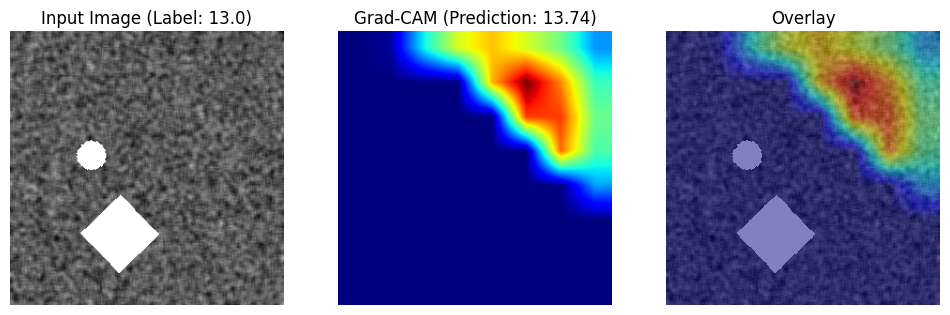

Max value in heatmap before ReLU is: tensor(0.0208, device='cuda:0', grad_fn=<MaxBackward1>)


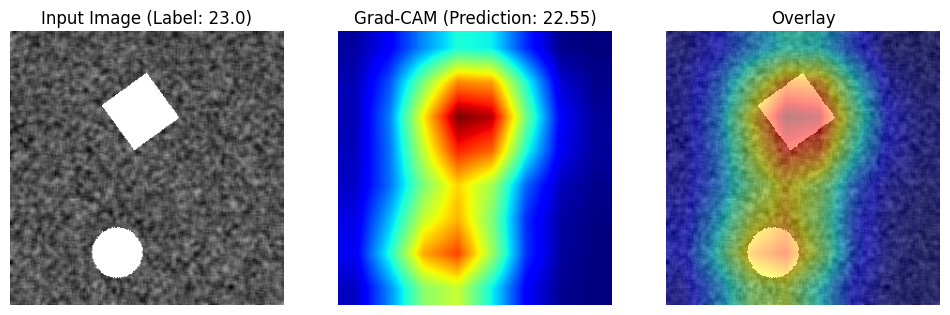

Max value in heatmap before ReLU is: tensor(0.0002, device='cuda:0', grad_fn=<MaxBackward1>)


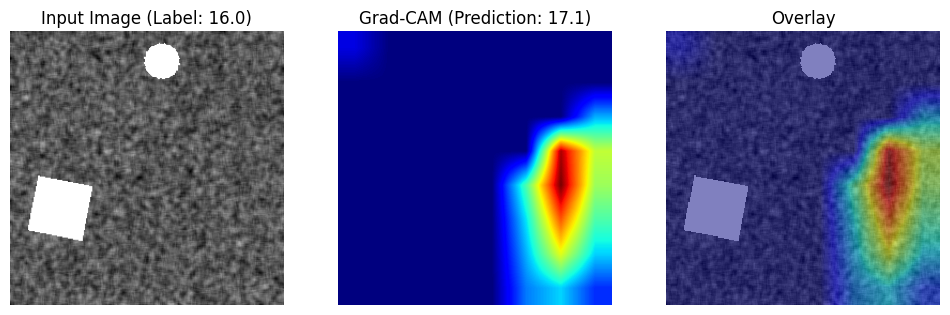

Max value in heatmap before ReLU is: tensor(0.0008, device='cuda:0', grad_fn=<MaxBackward1>)


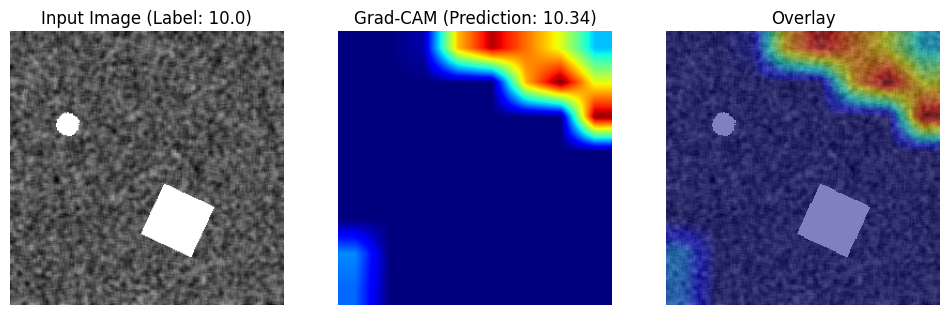

Max value in heatmap before ReLU is: tensor(0.0005, device='cuda:0', grad_fn=<MaxBackward1>)


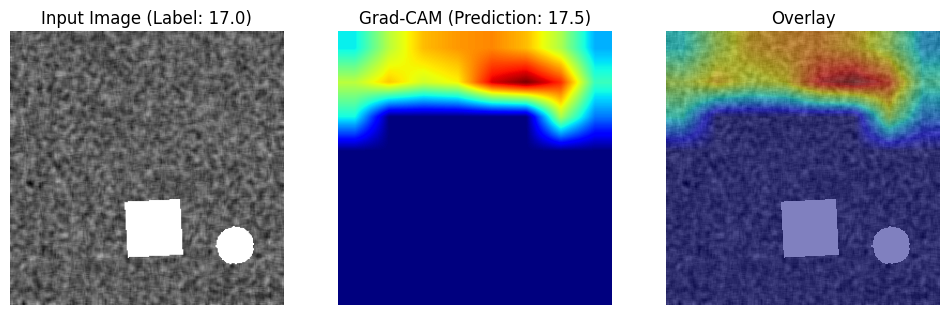

Max value in heatmap before ReLU is: tensor(0.0210, device='cuda:0', grad_fn=<MaxBackward1>)


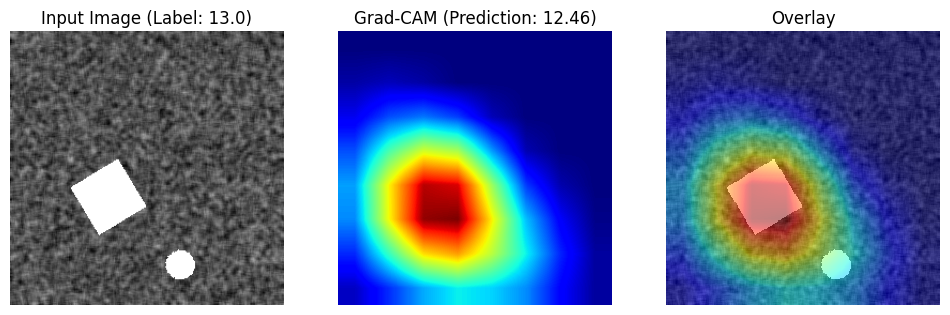

Max value in heatmap before ReLU is: tensor(0.0088, device='cuda:0', grad_fn=<MaxBackward1>)


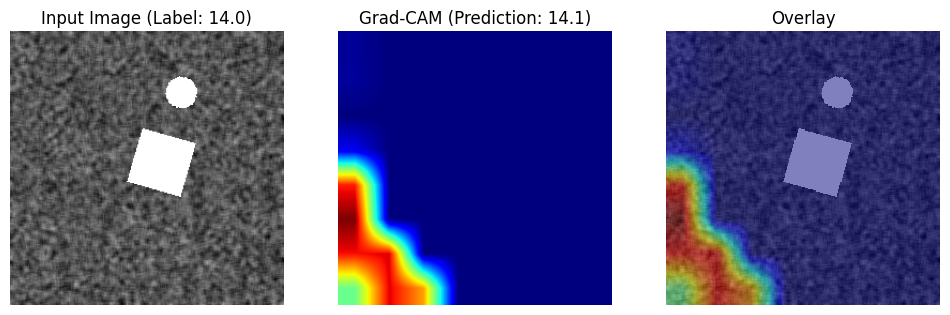

Max value in heatmap before ReLU is: tensor(2.9996e-05, device='cuda:0', grad_fn=<MaxBackward1>)


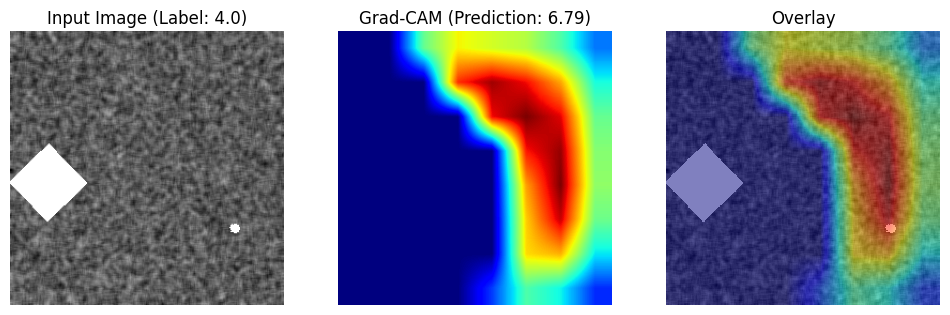

In [10]:
from src.XAI.ModifiedGradCam import ModifiedGradCam
importlib.reload(sys.modules['src.XAI.ModifiedGradCam'])
importlib.reload(sys.modules['src.XAI.utils.SaveFiles'])

grad_cam_mod = ModifiedGradCam(resnet)
for i in range(20):
    grad_cam_mod.generate_grad_cam(index=i)

In [54]:
from src.XAI.DeepShap import DeepShapResnet
importlib.reload(sys.modules['src.XAI.DeepShap'])

<module 'src.XAI.DeepShap' from 'c:\\Users\\askel\\OneDrive\\Dokumenter\\Projekter\\XAI-in-Medical-Image-Analysis\\src\\XAI\\DeepShap.py'>

[[[[[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   ...

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]]]]


AttributeError: 'Tensor' object has no attribute 'copy'

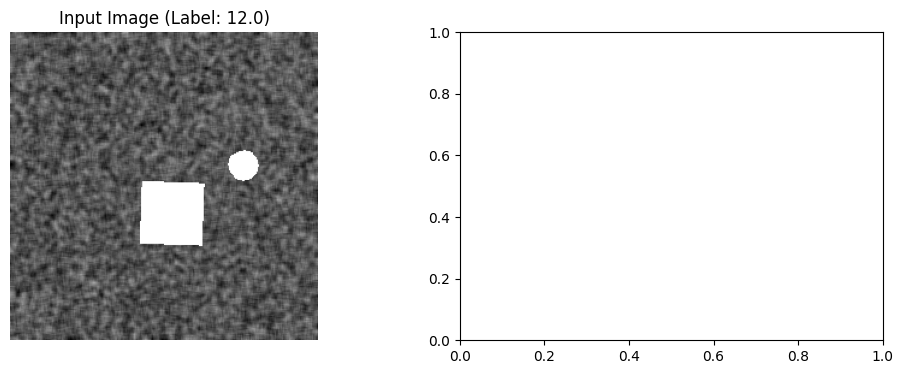

In [55]:
from src.XAI.DeepShap import DeepShapResnet
importlib.reload(sys.modules['src.XAI.DeepShap'])


# Initialize XAI instance
deepShap = DeepShapResnet(modelWrapper=resnet)

deepShap.generate_deep_shap(index=1)

In [51]:
from src.XAI.DeepShap import DeepShapResnet
importlib.reload(sys.modules['src.XAI.DeepShap'])


# Initialize XAI instance
deepShap = DeepShapResnet(modelWrapper=resnet)

deepShap.generate_deep_shap(index=1)

[[[[[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   ...

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]

   [[0.]
    [0.]
    [0.]
    ...
    [0.]
    [0.]
    [0.]]]]]


ValueError: The image data is not in an expected format for visualization.

In [32]:
from src.XAI.DeepShap import DeepShapResnet
importlib.reload(sys.modules['src.XAI.DeepShap'])

# Initialize XAI instance
deepShap = DeepShapResnet(modelWrapper=resnet)

for i in range(5):
    deepShap.generate_deep_shap(index=i)

RuntimeError: Cannot use both regular backward hooks and full backward hooks on a single Module. Please use only one of them.